# AT1 : Texgt Analysis
---
**36118 Applied Natural Language Processing** ,<br>
Name : Md Saifur Rahman <br> ID: 25528668


# Table of Contents
---
1. Task Overview
2. Data Preprocessing
3. EDA
4. Text Clustering
5. Topic Modeling
6. Network graph analysis
7. Analysis Findings
8. Conclusion



# 1. Task Overview
---
Skills classification can be one of the best way to understand the current trends in the job market which will also be helpful to understand the market demand and can also be helpful for the job seekers and the government what skills would be in demand in the future. In this project, I shall be analyzing the 

# Loading Data set

In [2]:
!pip install openpyxl
import pandas as pd
import numpy as np

from sklearn.feature_extraction.text import TfidfVectorizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')
nltk.download('stopwords')

# Load the Excel file
xls = pd.ExcelFile('https://github.com/saifrahmania/Data36118/raw/refs/heads/main/Assignment1/Data/ASCDataset/Australian%20Skills%20Classification%20-%20December%202023.xlsx')

# Dictionary to hold all DataFrames, one for each sheet
sheets_dict = {}

for sheet_name in xls.sheet_names:
    # Load each sheet into a DataFrame
    sheets_dict[sheet_name] = pd.read_excel(xls, sheet_name=sheet_name)

xls.sheet_names

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.9/250.9 kB 4.8 MB/s eta 0:00:00


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


['Index',
 'Glossary',
 'Occupation descriptions',
 'Core competency descriptions',
 'Specialist tasks hierarchy',
 'Tech tools heirarchy',
 'Core competencies',
 'Specialist tasks data',
 'Technology tools',
 'Appendix - tech tool examples',
 'Appendix - common tech tools']

# Data Inspection

In [4]:
for sheet_name in xls.sheet_names:
    print(f"Columns in sheet '{sheet_name}':")
    print(sheets_dict[sheet_name].columns.tolist())
    print("-" * 20)

Columns in sheet 'Index':
['Unnamed: 0', 'Unnamed: 1']
--------------------
Columns in sheet 'Glossary':
['Glossary of key terms', 'Unnamed: 1']
--------------------
Columns in sheet 'Occupation descriptions':
['Occupation Type', 'ANZSCO Code', 'Sub-Profile Code', 'ANZSCO Title', 'ANZSCO Description']
--------------------
Columns in sheet 'Core competency descriptions':
['Core Competency', 'Core Competency Description', 'Score', 'Proficiency Level', 'Anchor Value']
--------------------
Columns in sheet 'Specialist tasks hierarchy':
['Specialist Task', 'Specialist Cluster', 'Cluster Family', 'Skill Statement']
--------------------
Columns in sheet 'Tech tools heirarchy':
['Technology Tool Category', 'Technology Tool Category Description', 'Technology Tool', 'Technology Tool Description', 'Technology Tool Extended Description']
--------------------
Columns in sheet 'Core competencies':
['Occupation Type', 'ANZSCO Code', 'Sub-Profile Code', 'ANZSCO Title', 'Core Competency', 'Score', 'Pro

# Dividing Sheets

In [5]:
sheets_dict = {}

for sheet_name in xls.sheet_names:
    # Load each sheet into a DataFrame
    sheets_dict[sheet_name] = pd.read_excel(xls, sheet_name=sheet_name)

# Accessing specific sheets and their data
index_df = sheets_dict['Index']
glossary_df = sheets_dict['Glossary']
occupation_descriptions_df = sheets_dict['Occupation descriptions']
core_competency_descriptions_df = sheets_dict['Core competency descriptions']
specialist_tasks_hierarchy_df = sheets_dict['Specialist tasks hierarchy']
tech_tools_hierarchy_df = sheets_dict['Tech tools heirarchy']
core_competencies_df = sheets_dict['Core competencies']
specialist_tasks_data_df = sheets_dict['Specialist tasks data']
technology_tools_df = sheets_dict['Technology tools']
appendix_tech_tool_examples_df = sheets_dict['Appendix - tech tool examples']
appendix_common_tech_tools_df = sheets_dict['Appendix - common tech tools']

# Now you can work with each DataFrame individually
# Example: Print the first 5 rows of the 'Occupation descriptions' sheet
index_df.head()

,Unnamed: 0,Unnamed: 1
0,Australian Skills Classification,NaN
1,Version 3.0 - current at December 2023 - updat...,NaN
2,Index,NaN
3,Glossary,Explanation of key terms used in this dataset.
4,Occupation descriptions,ANZSCO Occupation codes and descriptions.\nSub...


In [6]:
specialist_tasks_data_df.columns.tolist()

['Occupation Type',
 'ANZSCO Code',
 'Sub-Profile Code',
 'ANZSCO Title',
 'Specialist Task',
 '% of time spent on task',
 'Emerging/\nTrending Flag',
 'Specialist Cluster',
 ' % of time spent on cluster',
 'Cluster Family',
 '% of time spent on family',
 'Skills Statement']

In [7]:
print(core_competencies_df.columns.tolist())

['Occupation Type', 'ANZSCO Code', 'Sub-Profile Code', 'ANZSCO Title', 'Core Competency', 'Score', 'Proficiency Level', 'Anchor Value']


In [8]:
try:
  core_competencies_df = core_competencies_df.drop(columns=['Sub-Profile Code'])
except KeyError:
  print("Column 'Sub-Profile Code' not found in 'core_competencies_df'")

try:
  specialist_tasks_data_df = specialist_tasks_data_df.drop(columns=['Sub-Profile Code'])
except KeyError:
  print("Column 'Sub-Profile Code' not found in 'specialist_tasks_data_df'")

In [9]:
core_competencies_df.shape


(11030, 7)

# Start merging Sheets

In [10]:
import pandas as pd

# Assuming specialist_tasks_data_df and core_competencies_df are loaded DataFrames

# First, let's ensure there are no duplicates within core_competencies_df that could cause multiple matches
core_competencies_df = core_competencies_df.drop_duplicates(subset=['Occupation Type', 'ANZSCO Title'], keep='first')


# Perform a left join with core_competencies_df to append matching data
merged_df = pd.merge(specialist_tasks_data_df, core_competencies_df,
                     on=['Occupation Type', 'ANZSCO Title'],
                     how='left')

# Check and print the number of rows and structure to ensure it matches expectations
print("After merge, DataFrame size: ", merged_df.shape)
print(merged_df.head())

# Optionally, check for any rows that might still have missing data indicating no match was found
unmatched_indicator = merged_df.isna().any(axis=1)
print("Number of unmatched rows: ", unmatched_indicator.sum())

# This approach ensures we do not inadvertently increase the number of rows in specialist_tasks_data_df.



After merge, DataFrame size:  (30450, 16)
  Occupation Type  ANZSCO Code_x                             ANZSCO Title  \
0        ANZSCO 4           1111  Chief Executives and Managing Directors   
1        ANZSCO 4           1111  Chief Executives and Managing Directors   
2        ANZSCO 4           1111  Chief Executives and Managing Directors   
3        ANZSCO 4           1111  Chief Executives and Managing Directors   
4        ANZSCO 4           1111  Chief Executives and Managing Directors   

                                     Specialist Task  % of time spent on task  \
0  Direct or manage financial activities or opera...                   0.1302   
1     Direct department or organisational activities                   0.1117   
2  Direct sales, marketing or customer service ac...                   0.0808   
3  Communicate with others to arrange, coordinate...                   0.0665   
4  Analyse data to assess operational or project ...                   0.0651   

  Emergi

In [11]:
merged_df.shape

(30450, 16)

In [12]:
merged_df.columns.tolist()

['Occupation Type',
 'ANZSCO Code_x',
 'ANZSCO Title',
 'Specialist Task',
 '% of time spent on task',
 'Emerging/\nTrending Flag',
 'Specialist Cluster',
 ' % of time spent on cluster',
 'Cluster Family',
 '% of time spent on family',
 'Skills Statement',
 'ANZSCO Code_y',
 'Core Competency',
 'Score',
 'Proficiency Level',
 'Anchor Value']

In [13]:
try:
  merged_df = merged_df.drop(columns=['% of time spent on task', 'Emerging/\nTrending Flag', ' % of time spent on cluster', '% of time spent on family', 'ANZSCO Code_y'])
except KeyError as e:
  print(f"Column not found: {e}")

In [14]:
merged_df.shape

(30450, 11)

In [15]:
# Count empty rows in each column of merged_df
empty_rows_per_column = merged_df.isnull().sum()

# Print the column names and the number of empty rows for each
for column, empty_count in empty_rows_per_column.items():
    print(f"Column '{column}': {empty_count} empty rows")

Column 'Occupation Type': 0 empty rows
Column 'ANZSCO Code_x': 0 empty rows
Column 'ANZSCO Title': 0 empty rows
Column 'Specialist Task': 0 empty rows
Column 'Specialist Cluster': 0 empty rows
Column 'Cluster Family': 0 empty rows
Column 'Skills Statement': 0 empty rows
Column 'Core Competency': 6568 empty rows
Column 'Score': 6568 empty rows
Column 'Proficiency Level': 6568 empty rows
Column 'Anchor Value': 6568 empty rows


In [16]:
# Drop rows where 'Core Competency', 'Score', and 'Anchor Value' are all null
merged_df = merged_df.dropna(subset=['Core Competency', 'Score', 'Anchor Value'], how='all')

In [17]:
merged_df.shape

(23882, 11)

In [18]:
merged_df.head()

,Occupation Type,ANZSCO Code_x,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,Anchor Value
0,ANZSCO 4,1111,Chief Executives and Managing Directors,Direct or manage financial activities or opera...,"Manage, monitor and undertake financial activi...",Business operations and financial activities,Direct and oversee the financial operations of...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
1,ANZSCO 4,1111,Chief Executives and Managing Directors,Direct department or organisational activities,"Manage services, staff or activities",Business operations and financial activities,Direct and oversee the activities of a work un...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
2,ANZSCO 4,1111,Chief Executives and Managing Directors,"Direct sales, marketing or customer service ac...","Manage services, staff or activities",Business operations and financial activities,"Direct and oversee the sales, marketing, or cu...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
3,ANZSCO 4,1111,Chief Executives and Managing Directors,"Communicate with others to arrange, coordinate...",Communicate or collaborate with others,Communication and collaboration,"Coordinate with others in order to plan, organ...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
4,ANZSCO 4,1111,Chief Executives and Managing Directors,Analyse data to assess operational or project ...,Use data to inform operational decisions,"Data, analytics, and databases",Analyse qualitative and quantitative data aris...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...


In [19]:
merged_df.columns.tolist()
merged_df.shape

(23882, 11)

In [20]:
try:
  merged_df = merged_df.rename(columns={'ANZSCO Code_x': 'ANZSCO Code'})
except KeyError as e:
  print(f"Column not found: {e}")

try:
    merged_df = merged_df.drop(columns=['Technology Tool_x', 'Technology Tool_y'])
except KeyError as e:
    print(f"Column not found: {e}")

Column not found: "['Technology Tool_x', 'Technology Tool_y'] not found in axis"


In [21]:
merged_df.columns.tolist()
occupation_descriptions_df.columns.tolist()

['Occupation Type',
 'ANZSCO Code',
 'Sub-Profile Code',
 'ANZSCO Title',
 'ANZSCO Description']

In [22]:
both_empty = merged_df[merged_df['Score'].isnull() & merged_df['Proficiency Level'].isnull()].shape[0]
print(f"Number of rows with both 'Score' and 'Proficiency Level' empty: {both_empty}")

# Count rows where 'Score' is empty/null/NaN but 'Proficiency Level' has a value
score_empty_proficiency_not = merged_df[merged_df['Score'].isnull() & merged_df['Proficiency Level'].notnull()].shape[0]
print(f"Number of rows with 'Score' empty but 'Proficiency Level' not empty: {score_empty_proficiency_not}")

# Count rows where 'Score' has a value but 'Proficiency Level' is empty/null/NaN
score_not_empty_proficiency_empty = merged_df[merged_df['Score'].notnull() & merged_df['Proficiency Level'].isnull()].shape[0]
print(f"Number of rows with 'Score' not empty but 'Proficiency Level' empty: {score_not_empty_proficiency_empty}")

# Count rows where either 'Score' or 'Proficiency Level' is empty/null/NaN
either_empty = merged_df[merged_df['Score'].isnull() | merged_df['Proficiency Level'].isnull()].shape[0]
print(f"Number of rows with either 'Score' or 'Proficiency Level' empty: {either_empty}")


Number of rows with both 'Score' and 'Proficiency Level' empty: 0
Number of rows with 'Score' empty but 'Proficiency Level' not empty: 0
Number of rows with 'Score' not empty but 'Proficiency Level' empty: 0
Number of rows with either 'Score' or 'Proficiency Level' empty: 0


In [23]:
# Calculate the mean of '% of time spent on task', '% of time spent on family', and 'Score', ignoring NaN values

mean_score = merged_df['Score'].mean()


merged_df['Score'].fillna(mean_score, inplace=True)

<ipython-input-23-02c996b9c362>:6: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  merged_df['Score'].fillna(mean_score, inplace=True)


In [24]:
empty_rows_per_column = merged_df.isnull().sum()

# Print the column names and the number of empty rows for each
for column, empty_count in empty_rows_per_column.items():
    print(f"Column '{column}': {empty_count} empty rows")

Column 'Occupation Type': 0 empty rows
Column 'ANZSCO Code': 0 empty rows
Column 'ANZSCO Title': 0 empty rows
Column 'Specialist Task': 0 empty rows
Column 'Specialist Cluster': 0 empty rows
Column 'Cluster Family': 0 empty rows
Column 'Skills Statement': 0 empty rows
Column 'Core Competency': 0 empty rows
Column 'Score': 0 empty rows
Column 'Proficiency Level': 0 empty rows
Column 'Anchor Value': 0 empty rows


In [25]:
# Drop rows where 'Core Competency', 'Anchor Value', and 'Core Competency' are null/NaN
merged_df = merged_df.dropna(subset=['Core Competency', 'Anchor Value'], how='any')

In [26]:
merged_df.shape

(23882, 11)

In [27]:
merged_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,Anchor Value
0,ANZSCO 4,1111,Chief Executives and Managing Directors,Direct or manage financial activities or opera...,"Manage, monitor and undertake financial activi...",Business operations and financial activities,Direct and oversee the financial operations of...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
1,ANZSCO 4,1111,Chief Executives and Managing Directors,Direct department or organisational activities,"Manage services, staff or activities",Business operations and financial activities,Direct and oversee the activities of a work un...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
2,ANZSCO 4,1111,Chief Executives and Managing Directors,"Direct sales, marketing or customer service ac...","Manage services, staff or activities",Business operations and financial activities,"Direct and oversee the sales, marketing, or cu...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
3,ANZSCO 4,1111,Chief Executives and Managing Directors,"Communicate with others to arrange, coordinate...",Communicate or collaborate with others,Communication and collaboration,"Coordinate with others in order to plan, organ...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...
4,ANZSCO 4,1111,Chief Executives and Managing Directors,Analyse data to assess operational or project ...,Use data to inform operational decisions,"Data, analytics, and databases",Analyse qualitative and quantitative data aris...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...


In [28]:
empty_rows_per_column = merged_df.isnull().sum()

# Print the column names and the number of empty rows for each
for column, empty_count in empty_rows_per_column.items():
    print(f"Column '{column}': {empty_count} empty rows")

Column 'Occupation Type': 0 empty rows
Column 'ANZSCO Code': 0 empty rows
Column 'ANZSCO Title': 0 empty rows
Column 'Specialist Task': 0 empty rows
Column 'Specialist Cluster': 0 empty rows
Column 'Cluster Family': 0 empty rows
Column 'Skills Statement': 0 empty rows
Column 'Core Competency': 0 empty rows
Column 'Score': 0 empty rows
Column 'Proficiency Level': 0 empty rows
Column 'Anchor Value': 0 empty rows


In [29]:
# Drop the specified columns from technology_tools_df
technology_tools_df = technology_tools_df.drop(columns=['Emerging/Trending Flag', 'Sub-Profile Code'], errors='ignore')

# Display the updated DataFrame (optional)
technology_tools_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,Technology Tool
0,ANZSCO 4,1111,Chief Executives and Managing Directors,Accounting and financial management systems
1,ANZSCO 4,1111,Chief Executives and Managing Directors,Audio/video conferencing software
2,ANZSCO 4,1111,Chief Executives and Managing Directors,Business intelligence and decision support sof...
3,ANZSCO 4,1111,Chief Executives and Managing Directors,Flow chart and diagram software
4,ANZSCO 4,1111,Chief Executives and Managing Directors,Human resources software


In [30]:
technology_tools_df.shape

(5761, 4)

In [31]:
technology_tools_aggregated = technology_tools_df.groupby(['Occupation Type', 'ANZSCO Title'])['Technology Tool'].apply(', '.join).reset_index()

# Merge final_df with this aggregated dataframe
merged_df = pd.merge(merged_df, technology_tools_aggregated, on=['Occupation Type', 'ANZSCO Title'], how='left')

# Now, merged_df will have an additional column 'Technology Tool' from technology_tools_df
# This column contains concatenated strings of tools, ensuring no increase in row count

# Display the head of the merged dataframe to verify
print(merged_df.head())

  Occupation Type  ANZSCO Code                             ANZSCO Title  \
0        ANZSCO 4         1111  Chief Executives and Managing Directors   
1        ANZSCO 4         1111  Chief Executives and Managing Directors   
2        ANZSCO 4         1111  Chief Executives and Managing Directors   
3        ANZSCO 4         1111  Chief Executives and Managing Directors   
4        ANZSCO 4         1111  Chief Executives and Managing Directors   

                                     Specialist Task  \
0  Direct or manage financial activities or opera...   
1     Direct department or organisational activities   
2  Direct sales, marketing or customer service ac...   
3  Communicate with others to arrange, coordinate...   
4  Analyse data to assess operational or project ...   

                                  Specialist Cluster  \
0  Manage, monitor and undertake financial activi...   
1               Manage services, staff or activities   
2               Manage services, staff or ac

In [32]:
for col in merged_df.columns:
    empty_count = merged_df[col].isnull().sum()
    print(f"Column '{col}': {empty_count} empty values")

Column 'Occupation Type': 0 empty values
Column 'ANZSCO Code': 0 empty values
Column 'ANZSCO Title': 0 empty values
Column 'Specialist Task': 0 empty values
Column 'Specialist Cluster': 0 empty values
Column 'Cluster Family': 0 empty values
Column 'Skills Statement': 0 empty values
Column 'Core Competency': 0 empty values
Column 'Score': 0 empty values
Column 'Proficiency Level': 0 empty values
Column 'Anchor Value': 0 empty values
Column 'Technology Tool': 2653 empty values


In [33]:
# Identify rows with missing 'Technology Tool' values
missing_tech_tool_rows = merged_df[merged_df['Technology Tool'].isnull()]

# Iterate through missing rows and try to find a match in technology_tools_df
for index, row in missing_tech_tool_rows.iterrows():
    # Find matching entries in technology_tools_df
    matched_tools = technology_tools_df[
        (technology_tools_df['Occupation Type'] == row['Occupation Type']) &
        (technology_tools_df['ANZSCO Title'] == row['ANZSCO Title'])
    ]['Technology Tool'].dropna().unique()  # Drop NaN values and get unique tools

    # If matches are found, update 'Technology Tool' column in merged_df
    if len(matched_tools) > 0:
        merged_df.at[index, 'Technology Tool'] = ', '.join(matched_tools)

# Verify if missing values are reduced
empty_count_after_filling = merged_df['Technology Tool'].isnull().sum()
print(f"After filling missing values, empty 'Technology Tool' count: {empty_count_after_filling}")

After filling missing values, empty 'Technology Tool' count: 2653


In [34]:
# Step 1: Standardize column values (strip spaces, lowercase)
merged_df['Occupation Type'] = merged_df['Occupation Type'].str.strip().str.lower()
merged_df['ANZSCO Title'] = merged_df['ANZSCO Title'].str.strip().str.lower()
technology_tools_df['Occupation Type'] = technology_tools_df['Occupation Type'].str.strip().str.lower()
technology_tools_df['ANZSCO Title'] = technology_tools_df['ANZSCO Title'].str.strip().str.lower()

# Step 2: Re-attempt merging
technology_tools_aggregated = technology_tools_df.groupby(['Occupation Type', 'ANZSCO Title'])['Technology Tool']\
                                                 .apply(lambda x: ', '.join(x.dropna().unique())).reset_index()

# Step 3: Merge again
merged_df = pd.merge(merged_df, technology_tools_aggregated, on=['Occupation Type', 'ANZSCO Title'], how='left', suffixes=('', '_new'))

# Step 4: Fill missing Technology Tools from re-merged column
merged_df['Technology Tool'] = merged_df['Technology Tool'].fillna(merged_df['Technology Tool_new'])

# Drop helper column after merging
merged_df.drop(columns=['Technology Tool_new'], inplace=True)

# Step 5: Identify remaining missing values
missing_tech_tool_rows = merged_df[merged_df['Technology Tool'].isnull()]

# Step 6: Debug - Check if missing job titles exist in technology_tools_df
missing_titles = missing_tech_tool_rows[['Occupation Type', 'ANZSCO Title']].drop_duplicates()
unmatched_titles = missing_titles.merge(technology_tools_df[['Occupation Type', 'ANZSCO Title']],
                                        on=['Occupation Type', 'ANZSCO Title'],
                                        how='left', indicator=True)

# Print titles that don't exist in technology_tools_df
print("Job titles that are missing in technology_tools_df:")
print(unmatched_titles[unmatched_titles['_merge'] == 'left_only'])

# Step 7: Final Check - Print remaining empty values count
empty_count_after_filling = merged_df['Technology Tool'].isnull().sum()
print(f"\nAfter second attempt, empty 'Technology Tool' count: {empty_count_after_filling}")


Job titles that are missing in technology_tools_df:
    Occupation Type                                       ANZSCO Title  \
0          anzsco 4                         horticultural crop growers   
1          anzsco 4      amusement, fitness and sports centre managers   
2          anzsco 4                     marine transport professionals   
3          anzsco 4  other health diagnostic and promotion professi...   
4          anzsco 4     welfare, recreation and community arts workers   
..              ...                                                ...   
137        anzsco 6                          vending machine attendant   
138        anzsco 6                                 car park attendant   
139        anzsco 6                                crossing supervisor   
140        anzsco 6  electrical or telecommunications trades assistant   
141        anzsco 6                          ticket collector or usher   

        _merge  
0    left_only  
1    left_only  
2    lef

In [35]:
merged_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,Anchor Value,Technology Tool
0,anzsco 4,1111,chief executives and managing directors,Direct or manage financial activities or opera...,"Manage, monitor and undertake financial activi...",Business operations and financial activities,Direct and oversee the financial operations of...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...,"Accounting and financial management systems, A..."
1,anzsco 4,1111,chief executives and managing directors,Direct department or organisational activities,"Manage services, staff or activities",Business operations and financial activities,Direct and oversee the activities of a work un...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...,"Accounting and financial management systems, A..."
2,anzsco 4,1111,chief executives and managing directors,"Direct sales, marketing or customer service ac...","Manage services, staff or activities",Business operations and financial activities,"Direct and oversee the sales, marketing, or cu...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...,"Accounting and financial management systems, A..."
3,anzsco 4,1111,chief executives and managing directors,"Communicate with others to arrange, coordinate...",Communicate or collaborate with others,Communication and collaboration,"Coordinate with others in order to plan, organ...",Digital engagement,6.0,Intermediate,Use software on a portable device to document ...,"Accounting and financial management systems, A..."
4,anzsco 4,1111,chief executives and managing directors,Analyse data to assess operational or project ...,Use data to inform operational decisions,"Data, analytics, and databases",Analyse qualitative and quantitative data aris...,Digital engagement,6.0,Intermediate,Use software on a portable device to document ...,"Accounting and financial management systems, A..."


In [36]:
!pip install fuzzywuzzy
!pip install python-Levenshtein

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.7/161.7 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 43.9 MB/s eta 0:00:00


In [37]:
from fuzzywuzzy import process

# Function to find closest matching job title
def find_closest_job(title, job_list):
    match, score = process.extractOne(title, job_list)
    return match if score > 80 else None  # Return only if similarity score > 80%

# Get unique job titles from technology_tools_df
existing_jobs = technology_tools_df['ANZSCO Title'].unique()

# Iterate through missing job titles and find closest matches
missing_tech_tool_rows = merged_df[merged_df['Technology Tool'].isnull()].copy()

for index, row in missing_tech_tool_rows.iterrows():
    closest_match = find_closest_job(row['ANZSCO Title'], existing_jobs)

    if closest_match:
        # Find corresponding technology tool for the closest matched job title
        matched_tools = technology_tools_df[technology_tools_df['ANZSCO Title'] == closest_match]['Technology Tool'].dropna().unique()

        if len(matched_tools) > 0:
            merged_df.at[index, 'Technology Tool'] = ', '.join(matched_tools)

# Final Check - Count remaining empty values
empty_count_final = merged_df['Technology Tool'].isnull().sum()
print(f"After fuzzy matching, empty 'Technology Tool' count: {empty_count_final}")

After fuzzy matching, empty 'Technology Tool' count: 713


In [38]:
# Assign "No Specific Tools" to remaining missing values
merged_df['Technology Tool'].fillna("No Specific Tools", inplace=True)

# Final check on missing values
empty_count_final = merged_df['Technology Tool'].isnull().sum()
print(f"After assigning default values, empty 'Technology Tool' count: {empty_count_final}")


After assigning default values, empty 'Technology Tool' count: 0


<ipython-input-38-6cf7402ffb4c>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  merged_df['Technology Tool'].fillna("No Specific Tools", inplace=True)


In [39]:
# Drop the specified column from occupation_descriptions_df
occupation_descriptions_df = occupation_descriptions_df.drop(columns=['Sub-Profile Code'], errors='ignore')

# Display the updated DataFrame (optional)
occupation_descriptions_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,ANZSCO Description
0,ANZSCO 4,1111,Chief Executives and Managing Directors,Chief Executives and Managing Directors determ...
1,ANZSCO 4,1112,General Managers,"General Managers plan, organise, direct, contr..."
2,ANZSCO 4,1211,Aquaculture Farmers,"Aquaculture Farmers plan, organise, control, c..."
3,ANZSCO 4,1213,Livestock Farmers,"Livestock Farmers plan, organise, control, coo..."
4,ANZSCO 4,1215,Broadacre Crop Growers,"Broadacre Crop Growers plan, organise, control..."


In [40]:
occupation_descriptions_df.shape

(1650, 4)

In [107]:
import pandas as pd

# Assuming merged_df is already loaded and contains the results from previous merging processes

# Perform the merge to add 'ANZSCO Description'
merged_df = pd.merge(merged_df, occupation_descriptions_df[['Occupation Type', 'ANZSCO Title', 'ANZSCO Description']],
                     on=['Occupation Type', 'ANZSCO Title'],
                     how='left')

# Now, merged_df will have an additional column 'ANZSCO Description' from occupation_descriptions_df
# This column contains descriptions based on the matched 'Occupation Type' and 'ANZSCO Title'

# Print the first few rows to verify the new structure and content


# Optionally, check the number of rows to ensure they haven't increased
print("Number of rows in the merged DataFrame:", len(merged_df))
merged_df.head()

Number of rows in the merged DataFrame: 23882


,Occupation Type,ANZSCO Code,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,...,bigrams,trigrams,description_length,ner,lemmatized,pos_tags,sentiment,sentiment_polarity,ANZSCO Description_y,ANZSCO Description_y
0,anzsco 6,394211,furniture finisher,"Grind materials, parts, or items",Operate production equipment and make products,Production processes and machinery,"Set up, adjust, and operate grinding tools or ...",Digital engagement,4.0,Intermediate,...,"[set adjust, adjust operate, operate grinding,...","[set adjust operate, adjust operate grinding, ...",52,[],"set , adjust , operate grind tool equipment ma...",VERB ADP PUNCT VERB PUNCT CCONJ VERB VERB NOUN...,0.222857,NaN,NaN,NaN
1,anzsco 6,394211,furniture finisher,"Fill cracks, imperfections or holes in product...",Repair parts or components,Production processes and machinery,"Apply fillers, sealants, compounds, or adhesiv...",Digital engagement,4.0,Intermediate,...,"[apply fillers, fillers sealants, sealants com...","[apply fillers sealants, fillers sealants comp...",29,[],"apply filler , sealant , compound , adhesive o...",VERB NOUN PUNCT NOUN PUNCT NOUN PUNCT CCONJ NO...,0.400000,NaN,NaN,NaN
2,anzsco 6,394211,furniture finisher,"Operate spraying, coating, or painting equipment",Apply paint or finishes,Construction,"Operate spraying, coating, or painting equipme...",Digital engagement,4.0,Intermediate,...,"[operate spraying, spraying coating, coating p...","[operate spraying coating, spraying coating pa...",67,[],"operate spray , coating , paint equipment ( sp...",VERB VERB PUNCT NOUN PUNCT CCONJ VERB NOUN PUN...,0.294444,NaN,NaN,NaN
3,anzsco 6,394211,furniture finisher,"Remove accessories, tools, components or other...",Remove or dismantle objects and equipment,Material transportation,Manually or with the assistance of tools or eq...,Digital engagement,4.0,Intermediate,...,"[manually assistance, assistance tools, tools ...","[manually assistance tools, assistance tools e...",22,[],"manually assistance tool equipment , remove ac...",ADV CCONJ ADP DET NOUN ADP NOUN CCONJ NOUN PUN...,0.366667,NaN,NaN,NaN
4,anzsco 6,394211,furniture finisher,"Confer with clients, customers, or designers t...",Communicate with others to coordinate work,Communication and collaboration,"Have discussions with customers, clients, or d...",Digital engagement,4.0,Intermediate,...,"[discussions customers, customers clients, cli...","[discussions customers clients, customers clie...",40,[],"discussion customer , client , designer determ...",VERB NOUN ADP NOUN PUNCT NOUN PUNCT CCONJ NOUN...,0.180000,NaN,NaN,NaN


In [103]:
try:
    merged_df = merged_df.drop(columns=['ANZSCO Description_y', 'ANZSCO Description'])
except KeyError as e:
    print(f"Column not found: {e}")

Column not found: "['ANZSCO Description'] not found in axis"


In [104]:
for col in merged_df.columns:
    empty_count = merged_df[col].isnull().sum()
    print(f"Column '{col}': {empty_count} empty values")

Column 'Occupation Type': 0 empty values
Column 'ANZSCO Code': 0 empty values
Column 'ANZSCO Title': 0 empty values
Column 'Specialist Task': 0 empty values
Column 'Specialist Cluster': 0 empty values
Column 'Cluster Family': 0 empty values
Column 'Skills Statement': 0 empty values
Column 'Core Competency': 0 empty values
Column 'Score': 0 empty values
Column 'Proficiency Level': 0 empty values
Column 'Anchor Value': 0 empty values
Column 'Technology Tool': 0 empty values
Column 'ANZSCO Description_x': 23882 empty values
Column 'Technology Tool Description': 0 empty values
Column 'Technology Tool Extended Description': 0 empty values
Column 'Technology Tool Category': 0 empty values
Column 'Technology Tool Category Description': 0 empty values
Column 'Processed_Skills_Manual': 0 empty values
Column 'bigrams': 0 empty values
Column 'trigrams': 0 empty values
Column 'description_length': 0 empty values
Column 'ner': 0 empty values
Column 'lemmatized': 0 empty values
Column 'pos_tags': 0 

In [105]:
try:
    merged_df = merged_df.rename(columns={'ANZSCO Description_x': 'ANZSCO Description'})
except KeyError as e:
    print(f"Column not found: {e}")

In [106]:
merged_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,...,Processed_Skills_Manual,bigrams,trigrams,description_length,ner,lemmatized,pos_tags,sentiment,sentiment_polarity,ANZSCO Description_y
0,anzsco 6,394211,furniture finisher,"Grind materials, parts, or items",Operate production equipment and make products,Production processes and machinery,"Set up, adjust, and operate grinding tools or ...",Digital engagement,4.0,Intermediate,...,set adjust operate grinding tools equipment ma...,"[set adjust, adjust operate, operate grinding,...","[set adjust operate, adjust operate grinding, ...",52,[],"set , adjust , operate grind tool equipment ma...",VERB ADP PUNCT VERB PUNCT CCONJ VERB VERB NOUN...,0.222857,NaN,NaN
1,anzsco 6,394211,furniture finisher,"Fill cracks, imperfections or holes in product...",Repair parts or components,Production processes and machinery,"Apply fillers, sealants, compounds, or adhesiv...",Digital engagement,4.0,Intermediate,...,apply fillers sealants compounds adhesives ord...,"[apply fillers, fillers sealants, sealants com...","[apply fillers sealants, fillers sealants comp...",29,[],"apply filler , sealant , compound , adhesive o...",VERB NOUN PUNCT NOUN PUNCT NOUN PUNCT CCONJ NO...,0.400000,NaN,NaN
2,anzsco 6,394211,furniture finisher,"Operate spraying, coating, or painting equipment",Apply paint or finishes,Construction,"Operate spraying, coating, or painting equipme...",Digital engagement,4.0,Intermediate,...,operate spraying coating painting equipment sp...,"[operate spraying, spraying coating, coating p...","[operate spraying coating, spraying coating pa...",67,[],"operate spray , coating , paint equipment ( sp...",VERB VERB PUNCT NOUN PUNCT CCONJ VERB NOUN PUN...,0.294444,NaN,NaN
3,anzsco 6,394211,furniture finisher,"Remove accessories, tools, components or other...",Remove or dismantle objects and equipment,Material transportation,Manually or with the assistance of tools or eq...,Digital engagement,4.0,Intermediate,...,manually assistance tools equipment remove acc...,"[manually assistance, assistance tools, tools ...","[manually assistance tools, assistance tools e...",22,[],"manually assistance tool equipment , remove ac...",ADV CCONJ ADP DET NOUN ADP NOUN CCONJ NOUN PUN...,0.366667,NaN,NaN
4,anzsco 6,394211,furniture finisher,"Confer with clients, customers, or designers t...",Communicate with others to coordinate work,Communication and collaboration,"Have discussions with customers, clients, or d...",Digital engagement,4.0,Intermediate,...,discussions customers clients designers determ...,"[discussions customers, customers clients, cli...","[discussions customers clients, customers clie...",40,[],"discussion customer , client , designer determ...",VERB NOUN ADP NOUN PUNCT NOUN PUNCT CCONJ NOUN...,0.180000,NaN,NaN


In [46]:
merged_df.shape

(23882, 13)

In [47]:
tech_tools_hierarchy_df.head()

,Technology Tool Category,Technology Tool Category Description,Technology Tool,Technology Tool Description,Technology Tool Extended Description
0,Broadcasting and audio-visual production techn...,"Systems for audio, video, multimedia and news ...",Collaborative news production platforms,Software used to create and manage news conten...,Collaborative news production platforms encomp...
1,Broadcasting and audio-visual production techn...,"Systems for audio, video, multimedia and news ...",Music or sound editing software,"Software used to create, manipulate, and edit ...",Music and sound editing software incorporates ...
2,Broadcasting and audio-visual production techn...,"Systems for audio, video, multimedia and news ...",Sound and audio hardware,"Apparatus used to create, manipulate, mix and/...",Hardware and equipment used to generate electr...
3,Broadcasting and audio-visual production techn...,"Systems for audio, video, multimedia and news ...",Video creation and editing software,Software used to create and edit digital video...,Video creation and editing software enables th...
4,Communication technologies,"Data, voice and/or video communication platforms",Audio/video conferencing software,Software for collaboration using video or audi...,Audio/video conferencing software enables peop...


In [48]:
nan_count = merged_df['Technology Tool'].isnull().sum()
print(f"Number of NaN values in 'Technology Tool' column: {nan_count}")

Number of NaN values in 'Technology Tool' column: 0


In [49]:
tech_tools_hierarchy_df.columns.tolist()

['Technology Tool Category',
 'Technology Tool Category Description',
 'Technology Tool',
 'Technology Tool Description',
 'Technology Tool Extended Description']

In [50]:
# Step 1: Ensure both dataframes are sorted for sequential traversal
merged_df = merged_df.sort_values(by=['Technology Tool']).reset_index(drop=True)
tech_tools_hierarchy_df = tech_tools_hierarchy_df.sort_values(by=['Technology Tool']).reset_index(drop=True)

# Step 2: Initialize index for tracking tech_tools_hierarchy_df
tech_index = 0

# Step 3: Iterate through merged_df and match 'Technology Tool' with tech_tools_hierarchy_df
for i in range(len(merged_df)):
    while tech_index < len(tech_tools_hierarchy_df) and merged_df.loc[i, 'Technology Tool'] == tech_tools_hierarchy_df.loc[tech_index, 'Technology Tool']:
        # Assign values from tech_tools_hierarchy_df to merged_df
        merged_df.at[i, 'Technology Tool Description'] = tech_tools_hierarchy_df.loc[tech_index, 'Technology Tool Description']
        merged_df.at[i, 'Technology Tool Extended Description'] = tech_tools_hierarchy_df.loc[tech_index, 'Technology Tool Extended Description']
        merged_df.at[i, 'Technology Tool Category'] = tech_tools_hierarchy_df.loc[tech_index, 'Technology Tool Category']
        merged_df.at[i, 'Technology Tool Category Description'] = tech_tools_hierarchy_df.loc[tech_index, 'Technology Tool Category Description']

        tech_index += 1  # Move to the next entry in tech_tools_hierarchy_df

    # Reset tech_index when end is reached
    if tech_index >= len(tech_tools_hierarchy_df):
        tech_index = 0

# Step 4: Fill remaining missing values with "Not Available" to ensure no NaN values
columns_to_fill = ['Technology Tool Description', 'Technology Tool Extended Description',
                   'Technology Tool Category', 'Technology Tool Category Description']
merged_df[columns_to_fill] = merged_df[columns_to_fill].fillna("Not Available")

merged_df.shape

(23882, 17)

In [51]:
merged_df.columns.tolist()

['Occupation Type',
 'ANZSCO Code',
 'ANZSCO Title',
 'Specialist Task',
 'Specialist Cluster',
 'Cluster Family',
 'Skills Statement',
 'Core Competency',
 'Score',
 'Proficiency Level',
 'Anchor Value',
 'Technology Tool',
 'ANZSCO Description',
 'Technology Tool Description',
 'Technology Tool Extended Description',
 'Technology Tool Category',
 'Technology Tool Category Description']

In [52]:
merged_df.shape

(23882, 17)

In [53]:
merged_df.head()

,Occupation Type,ANZSCO Code,ANZSCO Title,Specialist Task,Specialist Cluster,Cluster Family,Skills Statement,Core Competency,Score,Proficiency Level,Anchor Value,Technology Tool,ANZSCO Description,Technology Tool Description,Technology Tool Extended Description,Technology Tool Category,Technology Tool Category Description
0,anzsco 6,394211,furniture finisher,"Grind materials, parts, or items",Operate production equipment and make products,Production processes and machinery,"Set up, adjust, and operate grinding tools or ...",Digital engagement,4.0,Intermediate,Recognise different ways to connect to the int...,Accounting and financial management systems,NaN,"Software for managing accounts, inventory, and...",Accounting and financial management systems en...,Financial management and service delivery plat...,Systems to undertake financial management and ...
1,anzsco 6,394211,furniture finisher,"Fill cracks, imperfections or holes in product...",Repair parts or components,Production processes and machinery,"Apply fillers, sealants, compounds, or adhesiv...",Digital engagement,4.0,Intermediate,Recognise different ways to connect to the int...,Accounting and financial management systems,NaN,Not Available,Not Available,Not Available,Not Available
2,anzsco 6,394211,furniture finisher,"Operate spraying, coating, or painting equipment",Apply paint or finishes,Construction,"Operate spraying, coating, or painting equipme...",Digital engagement,4.0,Intermediate,Recognise different ways to connect to the int...,Accounting and financial management systems,NaN,Not Available,Not Available,Not Available,Not Available
3,anzsco 6,394211,furniture finisher,"Remove accessories, tools, components or other...",Remove or dismantle objects and equipment,Material transportation,Manually or with the assistance of tools or eq...,Digital engagement,4.0,Intermediate,Recognise different ways to connect to the int...,Accounting and financial management systems,NaN,Not Available,Not Available,Not Available,Not Available
4,anzsco 6,394211,furniture finisher,"Confer with clients, customers, or designers t...",Communicate with others to coordinate work,Communication and collaboration,"Have discussions with customers, clients, or d...",Digital engagement,4.0,Intermediate,Recognise different ways to connect to the int...,Accounting and financial management systems,NaN,Not Available,Not Available,Not Available,Not Available


In [54]:
# Calculate the ratio of missing values for specific columns
columns_to_check = ['Technology Tool Category', 'Technology Tool Category Description', 'Technology Tool Description', 'Technology Tool Extended Description']
total_rows = len(merged_df)

for column in columns_to_check:
    missing_count = merged_df[column].isnull().sum()
    missing_ratio = missing_count / total_rows
    print(f"Ratio of missing values in '{column}': {missing_ratio:.4f}")

Ratio of missing values in 'Technology Tool Category': 0.0000
Ratio of missing values in 'Technology Tool Category Description': 0.0000
Ratio of missing values in 'Technology Tool Description': 0.0000
Ratio of missing values in 'Technology Tool Extended Description': 0.0000


In [55]:
# Assuming 'merged_df' is the DataFrame you want to export
merged_df.to_csv('merged_data.csv', index=False)  # Set index=False to avoid saving row indices

# EDA

In [108]:

import pandas as pd

url = "https://raw.githubusercontent.com/saifrahmania/Data36118/refs/heads/main/Assignment1/Data/merged_data.csv"
data = pd.read_csv(url)
# Display dataset shape
print("Dataset Shape:", data.shape)

# Check for missing values
print("Missing Values:\n", data.isnull().sum())

# Inspect the first few rows
print("First Few Rows:\n", data.head())


Dataset Shape: (23882, 17)
Missing Values:
 Occupation Type                         0
ANZSCO Code                             0
ANZSCO Title                            0
Specialist Task                         0
Specialist Cluster                      0
Cluster Family                          0
Skills Statement                        0
Core Competency                         0
Score                                   0
Proficiency Level                       0
Anchor Value                            0
ANZSCO Description                      0
Technology Tool                         0
Technology Tool Category                0
Technology Tool Category Description    0
Technology Tool Description             0
Technology Tool Extended Description    0
dtype: int64
First Few Rows:
   Occupation Type  ANZSCO Code        ANZSCO Title  \
0        anzsco 6       394211  furniture finisher   
1        anzsco 6       394211  furniture finisher   
2        anzsco 6       394211  furniture finisher

In [109]:
# Step 1.1: Load and Inspect Data
# Already loaded and inspected, so I will define the DataFrame variable name as 'df' to be used throughout the analysis.
df = data

# Step 1.2: Descriptive Statistics
# Count the number of unique skills, job roles (using ANZSCO Title), and industries (using Occupation Type).
unique_skills = df['Skills Statement'].nunique()
unique_job_roles = df['ANZSCO Title'].nunique()
unique_industries = df['Occupation Type'].nunique()

# Analyze the distribution of skills across different categories (Specialist Cluster).
skills_distribution = df['Specialist Cluster'].value_counts()

# Check the frequency of unique job titles and their variations.
job_titles_frequency = df['ANZSCO Title'].value_counts()

# Step 1.3: Handling Missing Data
# No missing data found from initial inspection. Confirming if any columns have missing data and need handling.
missing_data_check = df.isnull().any()

# Display results from Descriptive Statistics and Missing Data Check
unique_skills, unique_job_roles, unique_industries, skills_distribution.head(), job_titles_frequency.head(), missing_data_check


(1653,
 1101,
 2,
 Specialist Cluster
 Provide customer service and communicate information                 490
 Undertake or provide professional skill and knowledge development    444
 Inspect, test or maintain equipment or systems                       435
 Communicate or collaborate with others                               413
 Provide health care or administer medical treatment                  412
 Name: count, dtype: int64,
 ANZSCO Title
 web administrator                  45
 systems administrator              45
 dance teacher (private tuition)    44
 primary school teacher             43
 primary school teachers            43
 Name: count, dtype: int64,
 Occupation Type                         False
 ANZSCO Code                             False
 ANZSCO Title                            False
 Specialist Task                         False
 Specialist Cluster                      False
 Cluster Family                          False
 Skills Statement                        Fals

Top 20 Most Frequent Words and Their Frequencies:
ensure: 12778
equipment: 12227
relevant: 10932
information: 10188
order: 10023
work: 9310
requirements: 8498
include: 8473
safety: 7701
standards: 7494
procedures: 7070
involve: 5776
materials: 5392
activities: 5365
appropriate: 5354
data: 5328
regulations: 5322
technical: 4901
issues: 4748
health: 4207


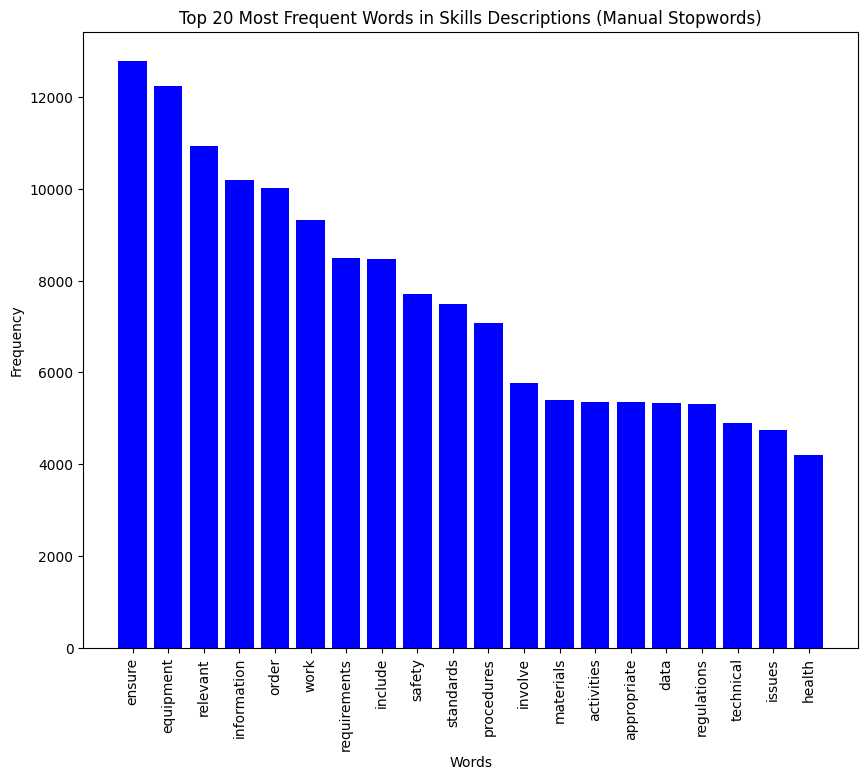

In [110]:
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer

# Step 2.1: Word Frequency Analysis
# Define a basic set of English stopwords manually as a fallback
manual_stopwords = {'and', 'the', 'to', 'of', 'a', 'in', 'for', 'on', 'with', 'as', 'by', 'is', 'that', 'it', 'from', 'this', 'be', 'which', 'or', 'are', 'was', 'will', 'at', 'an', 'have', 'not', 'their', 'has', 'can', 'all', 'any', 'if', 'but', 'they', 'you', 'your', 'one', 'what', 'some', 'other', 'such', 'into', 'do', 'also', 'use', 'used', 'using', 'up', 'out', 'about', 'than', 'more', 'its', 'each', 'when', 'how', 'like', 'these', 'just', 'his', 'her', 'over', 'who', 'them', 'get', 'may', 'new', 'would'}

# Update the text preprocessing function using the manual list of stopwords
def preprocess_text_manual(text):
    text = text.lower()
    text = ''.join([char for char in text if char.isalnum() or char.isspace()])
    tokens = [word for word in text.split() if word not in manual_stopwords]
    return ' '.join(tokens)

# Apply the updated text preprocessing
df['Processed_Skills_Manual'] = df['Skills Statement'].apply(preprocess_text_manual)

# Import CountVectorizer from sklearn
from sklearn.feature_extraction.text import CountVectorizer

# Count the most frequently used words again
vectorizer_manual = CountVectorizer()
word_matrix_manual = vectorizer_manual.fit_transform(df['Processed_Skills_Manual'])
word_counts_manual = word_matrix_manual.sum(axis=0)
words_freq_manual = [(word, word_counts_manual[0, idx]) for word, idx in vectorizer_manual.vocabulary_.items()]
words_freq_manual = sorted(words_freq_manual, key=lambda x: x[1], reverse=True)[:20]

# Displaying the words and their frequencies
print("Top 20 Most Frequent Words and Their Frequencies:")
for word, freq in words_freq_manual:
    print(f"{word}: {freq}")


# Create bar charts again with the updated data
words_manual, counts_manual = zip(*words_freq_manual)
plt.figure(figsize=(10, 8))
plt.bar(words_manual, counts_manual, color='blue')
plt.xlabel('Words')
plt.ylabel('Frequency')
plt.title('Top 20 Most Frequent Words in Skills Descriptions (Manual Stopwords)')
plt.xticks(rotation=90)
plt.show()

Top 20 Most Frequent Bigrams:
health safety            1917
relevant information     1557
order ensure             1410
work activities          1169
technical knowledge      1141
work health              1090
policies procedures      1086
specialist technical     1074
include providing        1016
regulations standards     975
safety standards          972
order determine           969
adhere relevant           946
select appropriate        940
relevant regulations      918
protective equipment      852
ensure safety             844
industry standards        843
personal protective       812
relevant standards        812
Name: count, dtype: int64

Top 20 Most Frequent Trigrams:
work health safety                1090
specialist technical knowledge     874
personal protective equipment      749
project management tasks           623
providing specialist technical     592
technical knowledge guidance       576
general project management         565
undertaking general project        565


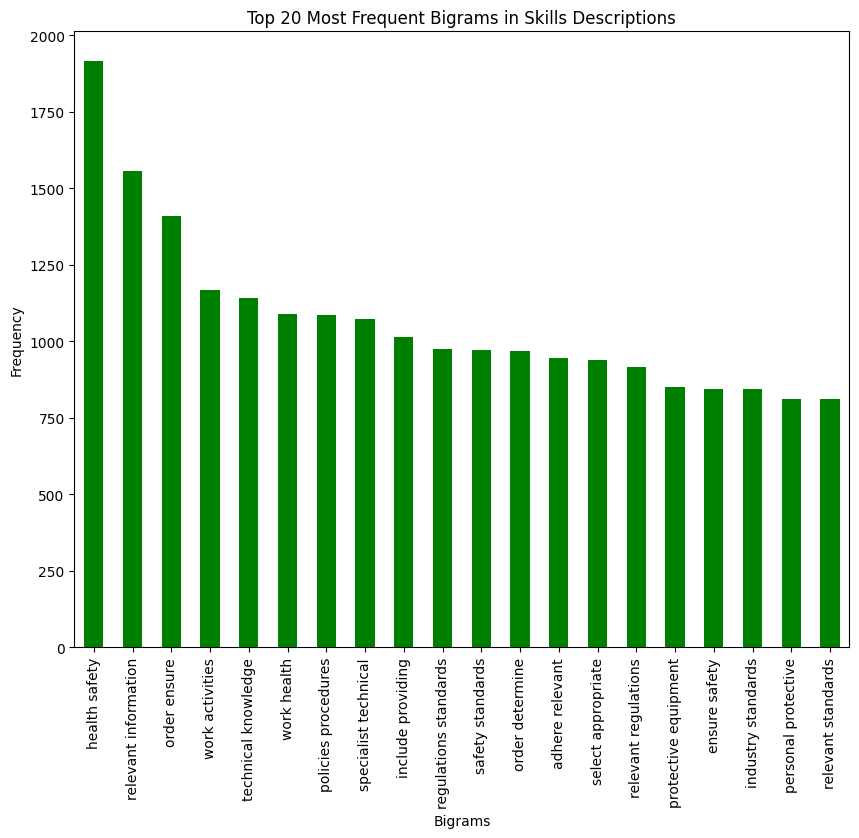

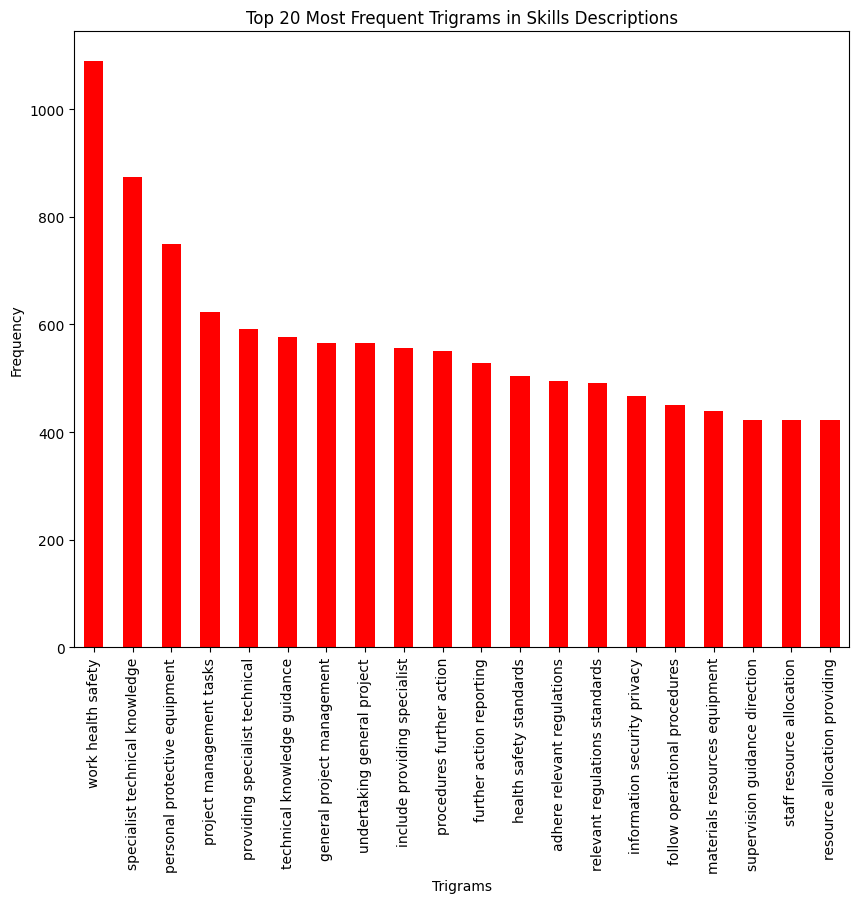

In [111]:
# Step 2.2: N-Grams Analysis (Phrase Extraction)
# Using the preprocessed text to generate bigrams and trigrams

# Function to generate n-grams
def generate_ngrams(text, n=2):
    words = text.split()
    ngrams = zip(*[words[i:] for i in range(n)])
    return [' '.join(ngram) for ngram in ngrams]

# Apply the function to generate bigrams and trigrams
df['bigrams'] = df['Processed_Skills_Manual'].apply(generate_ngrams, n=2)
df['trigrams'] = df['Processed_Skills_Manual'].apply(generate_ngrams, n=3)

# Flatten the list of bigrams and trigrams to count frequency
all_bigrams = [bigram for sublist in df['bigrams'].tolist() for bigram in sublist]
all_trigrams = [trigram for sublist in df['trigrams'].tolist() for trigram in sublist]

# Count frequency of bigrams and trigrams
bigram_freq = pd.Series(all_bigrams).value_counts().head(20)
trigram_freq = pd.Series(all_trigrams).value_counts().head(20)

print("Top 20 Most Frequent Bigrams:")
print(bigram_freq)

print("\nTop 20 Most Frequent Trigrams:")
print(trigram_freq)

# Plot the top 20 bigrams
plt.figure(figsize=(10, 8))
bigram_freq.plot(kind='bar', color='green')
plt.title('Top 20 Most Frequent Bigrams in Skills Descriptions')
plt.xlabel('Bigrams')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.show()

# Plot the top 20 trigrams
plt.figure(figsize=(10, 8))
trigram_freq.plot(kind='bar', color='red')
plt.title('Top 20 Most Frequent Trigrams in Skills Descriptions')
plt.xlabel('Trigrams')
plt.ylabel('Frequency')
plt.xticks(rotation=90)
plt.show()


In [112]:
!pip install wordcloud

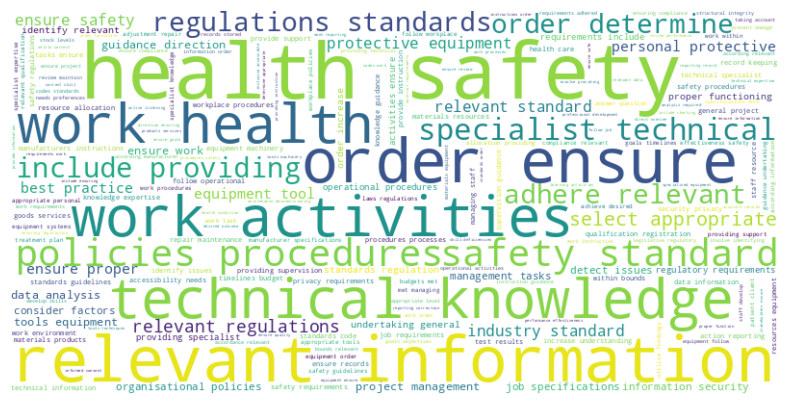

In [113]:
# Step 2.3: Word Cloud Visualization
from wordcloud import WordCloud

# Function to generate a word cloud
def generate_word_cloud(text_series):
    text_combined = ' '.join(text_series)
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text_combined)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

# Generate word cloud for all skills descriptions
generate_word_cloud(df['Processed_Skills_Manual'])


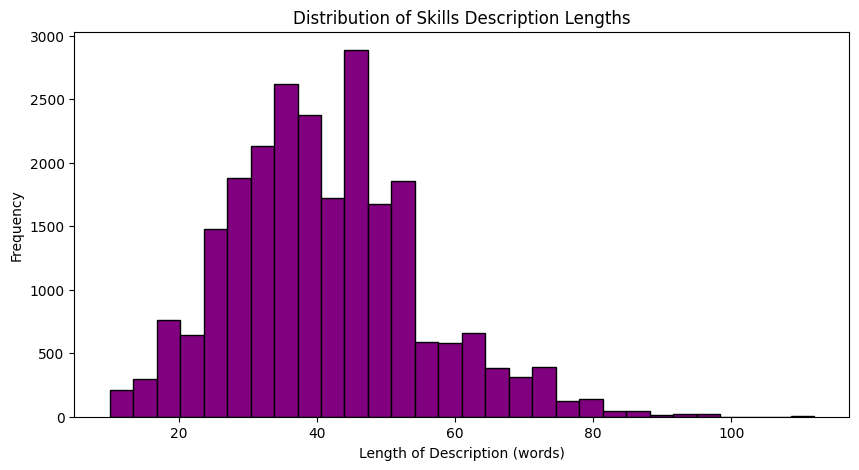

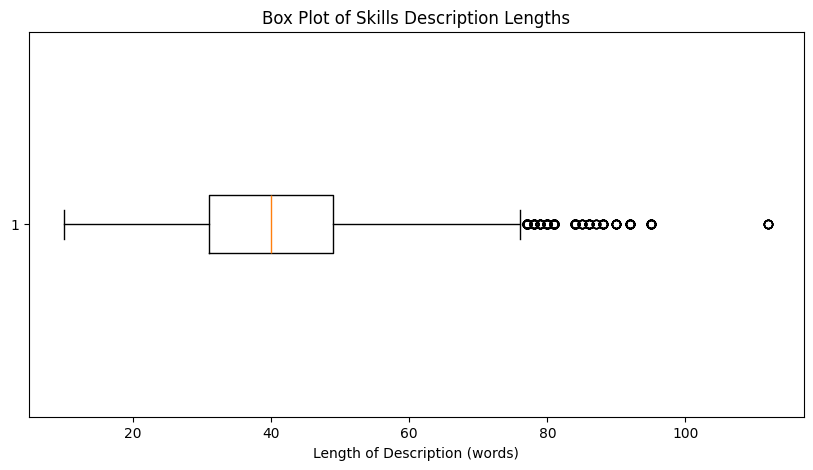

In [114]:
# Step 2.4: Text Length Distribution
# Calculate the length of each skill description in words
df['description_length'] = df['Processed_Skills_Manual'].apply(lambda x: len(x.split()))

# Plot the histogram of description lengths
plt.figure(figsize=(10, 5))
plt.hist(df['description_length'], bins=30, color='purple', edgecolor='black')
plt.title('Distribution of Skills Description Lengths')
plt.xlabel('Length of Description (words)')
plt.ylabel('Frequency')
plt.show()

# Additionally, use a box plot to see the variation and outliers
plt.figure(figsize=(10, 5))
plt.boxplot(df['description_length'], vert=False)
plt.title('Box Plot of Skills Description Lengths')
plt.xlabel('Length of Description (words)')
plt.show()


In [115]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import LatentDirichletAllocation
import numpy as np

# Step 3.1: TF-IDF Vectorization
# Limiting to top 1000 features for simplicity and using float32 for memory efficiency
tfidf_vectorizer = TfidfVectorizer(max_features=1000, dtype=np.float32)
tfidf_matrix = tfidf_vectorizer.fit_transform(df['Processed_Skills_Manual'])

# Get feature names to use as dataframe columns
tfidf_feature_names = tfidf_vectorizer.get_feature_names_out()

# Step 3.2: Cosine Similarity (Skill Matching)
# Measure similarity between skills using cosine similarity
# Computing cosine similarity in chunks to manage memory usage
def chunked_cosine_similarity(matrix, chunk_size=1000):
    cosine_sim = []
    for i in range(0, matrix.shape[0], chunk_size):
        cosine_sim.append(cosine_similarity(matrix[i:i+chunk_size], matrix))
    return np.vstack(cosine_sim)

cosine_sim_matrix = chunked_cosine_similarity(tfidf_matrix)

# Display part of the cosine similarity matrix
print(cosine_sim_matrix[:5, :5])  # Show the top-left corner of the matrix for brevity

# Step 3.3: Topic Modeling using Latent Dirichlet Allocation (LDA)
# Use LDA with batch_size for memory management
lda = LatentDirichletAllocation(n_components=5, random_state=0, learning_method='batch', batch_size=128)
lda.fit(tfidf_matrix)

# Function to display topics and their top words
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx + 1))
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

# Display the topics
display_topics(lda, tfidf_feature_names, 10)


[[1.         0.09233322 0.14015481 0.2647536  0.140082  ]
 [0.09233322 1.         0.09939328 0.03324211 0.        ]
 [0.14015481 0.09939328 1.         0.0833383  0.03711684]
 [0.2647536  0.03324211 0.0833383  0.99999994 0.33450142]
 [0.140082   0.         0.03711684 0.33450142 1.        ]]
Topic 1:
activities staff provide support providing ensure needs skills work learning
Topic 2:
order data materials information requirements equipment products determine analysis standards
Topic 3:
information relevant medical patient procedures equipment regulations ensure issues standards
Topic 4:
equipment work tools requirements ensure specifications order appropriate safety design
Topic 5:
equipment include materials data financial items business relevant products resources


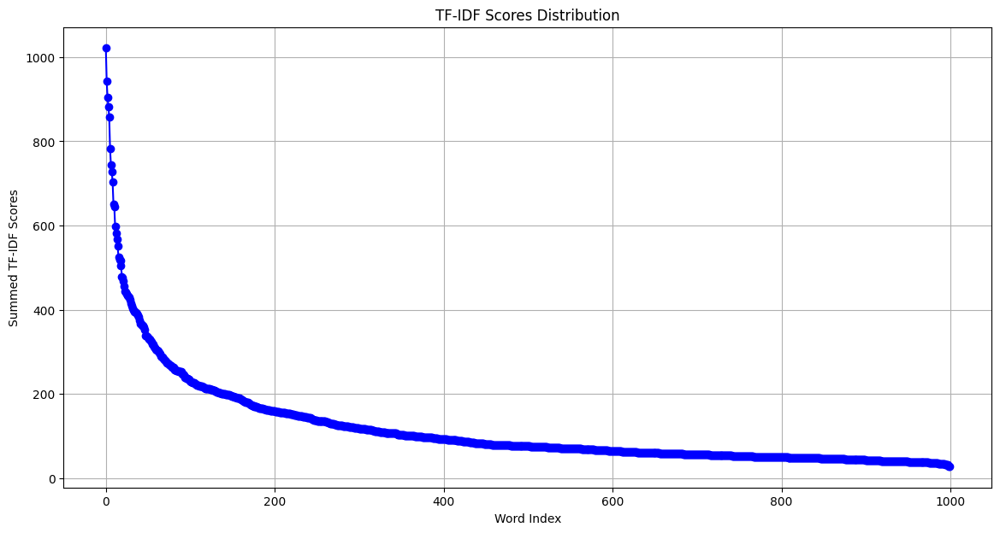

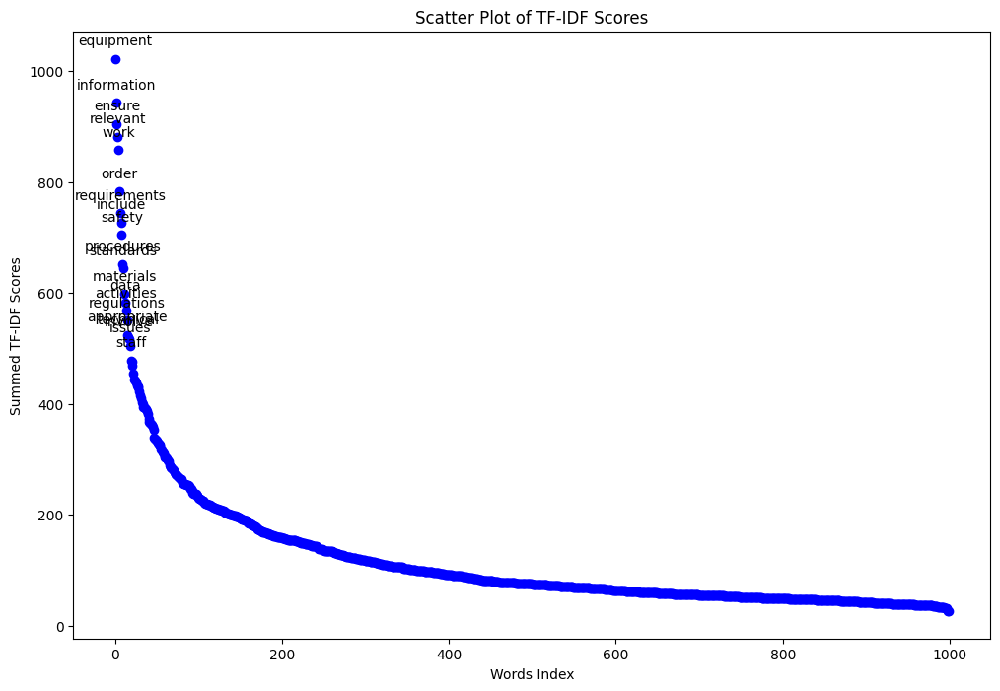

In [116]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'tfidf_matrix' and 'tfidf_feature_names' are defined
# Sum the TF-IDF scores for each term across all documents and ensure it's a flat array
sum_tfidf = np.sum(tfidf_matrix, axis=0).A1  # Use .A1 to flatten the matrix to a 1D array if it's a scipy sparse matrix

words = np.array(tfidf_feature_names)  # Feature names (words)
sorted_indices = np.argsort(sum_tfidf)[::-1]  # Sort by score
sorted_words = words[sorted_indices]
sorted_scores = sum_tfidf[sorted_indices]

# Option 1: Line Plot
plt.figure(figsize=(14, 7))
plt.plot(sorted_scores, marker='o', linestyle='-', color='b')
plt.title('TF-IDF Scores Distribution')
plt.ylabel('Summed TF-IDF Scores')
plt.xlabel('Word Index')
plt.grid(True)
plt.show()

# Option 2: Scatter Plot
plt.figure(figsize=(12, 8))
plt.scatter(range(len(sorted_words)), sorted_scores, color='blue')
top_n = 20  # Number of top words to annotate
for i in range(top_n):
    plt.annotate(sorted_words[i], (i, sorted_scores[i]), textcoords="offset points", xytext=(0,10), ha='center')
plt.title('Scatter Plot of TF-IDF Scores')
plt.xlabel('Words Index')
plt.ylabel('Summed TF-IDF Scores')
plt.show()


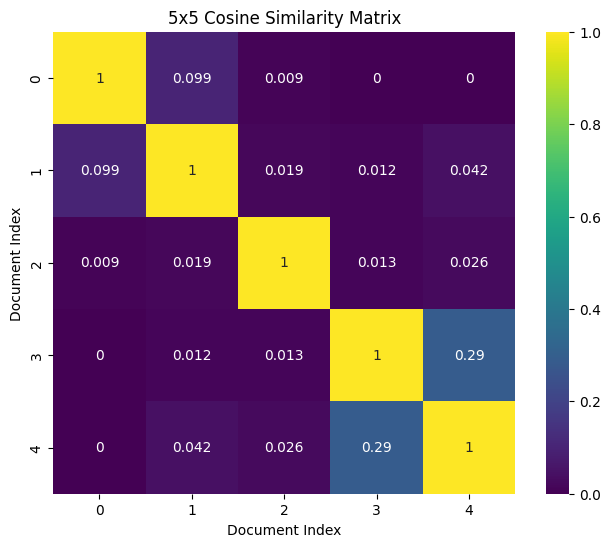

In [117]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Assuming 'cosine_sim_matrix' is already computed
# Define a smaller subset size for a more focused view
subset_size = 5  # Set to 5 for a 5x5 matrix

num_docs = cosine_sim_matrix.shape[0]

if num_docs > subset_size:
    # Choose a random subset of indices to reduce the dataset size
    np.random.seed(0)  # For reproducibility
    indices = np.random.choice(num_docs, subset_size, replace=False)
    sim_subset = cosine_sim_matrix[indices, :][:, indices]
else:
    sim_subset = cosine_sim_matrix  # Use the entire matrix if it's smaller than the subset size

# Plot the subset of the cosine similarity matrix
plt.figure(figsize=(8, 6))
sns.heatmap(sim_subset, annot=True, cmap='viridis', square=True)  # `annot=True` to show the similarity scores
plt.title('5x5 Cosine Similarity Matrix')
plt.xlabel('Document Index')
plt.ylabel('Document Index')
plt.show()


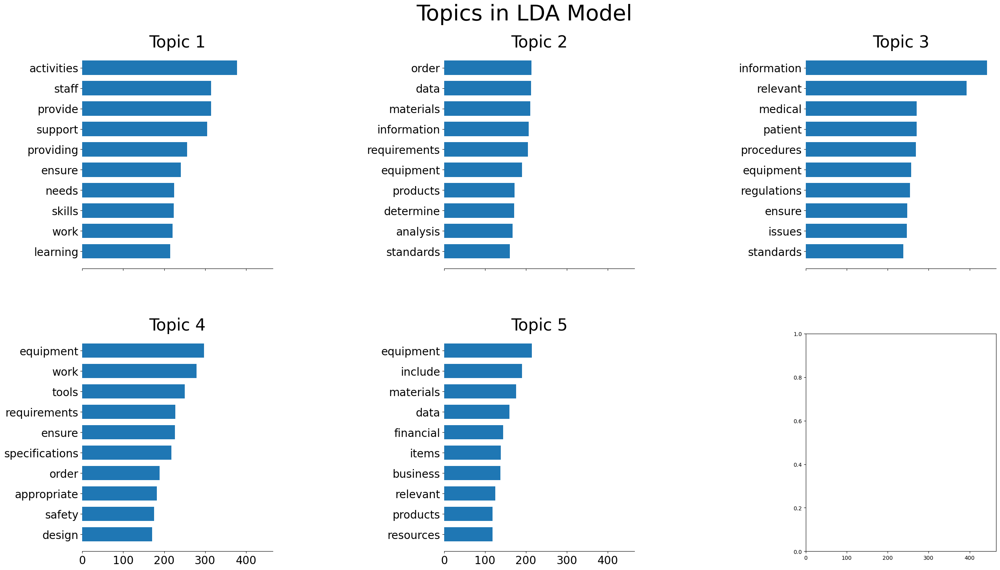

In [118]:
import matplotlib.pyplot as plt
import numpy as np

def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(2, 3, figsize=(30, 15), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f'Topic {topic_idx +1}',
                     fontdict={'fontsize': 30})
        ax.invert_yaxis()
        ax.tick_params(axis='both', which='major', labelsize=20)
        for i in 'top right left'.split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()

# Assuming 'lda', 'tfidf_feature_names' are defined from your code
plot_top_words(lda, tfidf_feature_names, 10, 'Topics in LDA Model')

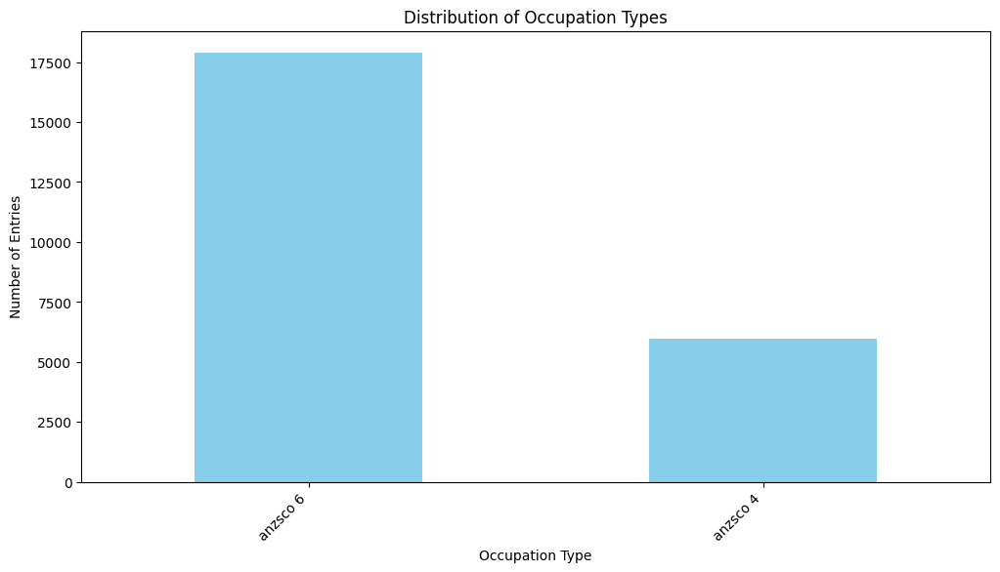

In [119]:
import matplotlib.pyplot as plt

# Group by 'Occupation Type' and count entries in each category
occupation_grouped = df['Occupation Type'].value_counts()

# Plotting the distribution of Occupation Types
plt.figure(figsize=(12, 6))
occupation_grouped.plot(kind='bar', color='skyblue')
plt.title('Distribution of Occupation Types')
plt.xlabel('Occupation Type')
plt.ylabel('Number of Entries')
plt.xticks(rotation=45, ha='right')
plt.show()


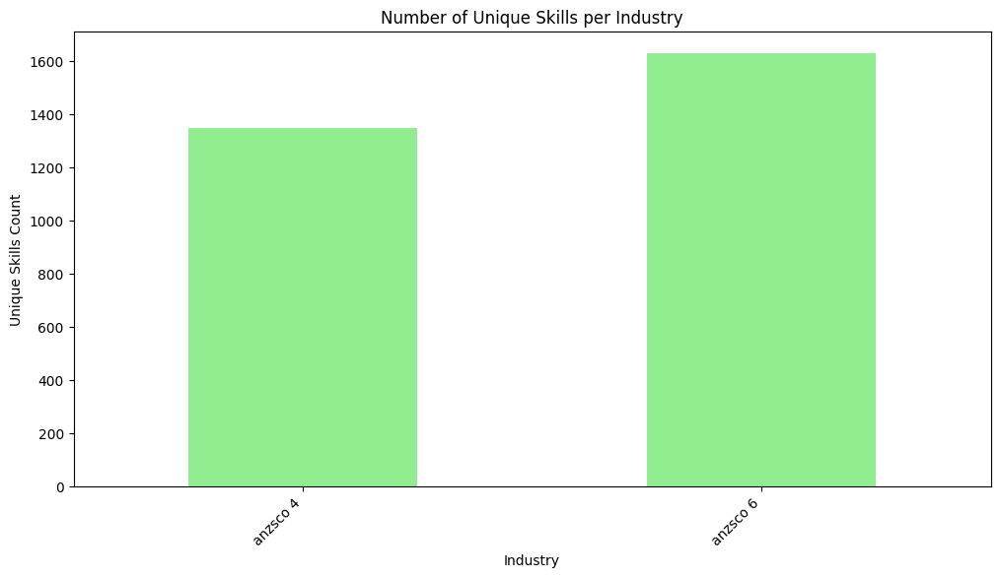

Common Skills in anzsco 4 and anzsco 6: 1324
Unique Skills in anzsco 4 and anzsco 6: 329


In [120]:
# Group skills by 'Occupation Type' and aggregate the unique skills in each category
industry_skills = df.groupby('Occupation Type')['Skills Statement'].nunique()

# Visualizing the number of unique skills per industry
plt.figure(figsize=(12, 6))
industry_skills.plot(kind='bar', color='lightgreen')
plt.title('Number of Unique Skills per Industry')
plt.xlabel('Industry')
plt.ylabel('Unique Skills Count')
plt.xticks(rotation=45, ha='right')
plt.show()

# Identify overlapping and unique skills across industries by creating sets of skills for each industry and comparing them
skills_sets = df.groupby('Occupation Type')['Skills Statement'].apply(set).to_dict()

# Example of comparing skills between two industries (replace 'Industry1' and 'Industry2' with actual industry names)
# This is assuming there are multiple industries, replace the keys with actual ones from your data
industries = list(skills_sets.keys())
if len(industries) > 1:
    common_skills = skills_sets[industries[0]].intersection(skills_sets[industries[1]])
    unique_skills = skills_sets[industries[0]].symmetric_difference(skills_sets[industries[1]])

    print(f"Common Skills in {industries[0]} and {industries[1]}: {len(common_skills)}")
    print(f"Unique Skills in {industries[0]} and {industries[1]}: {len(unique_skills)}")


In [121]:
import spacy
from spacy import displacy

# Load the English NLP model from spaCy
nlp = spacy.load("en_core_web_sm")

# Function to apply NER and extract entities
def extract_entities(text):
    doc = nlp(text)
    return [(ent.text, ent.label_) for ent in doc.ents]

# Apply the function to the 'Skills Statement' column
df['ner'] = df['Skills Statement'].apply(extract_entities)

# Print the first few entries with non-empty NER results
for index, ner_entries in enumerate(df['ner']):
    if ner_entries:  # Only display non-empty NER results
        print(f"Index {index}: {ner_entries}")
    if index > 20:  # Limit output to first 20 non-empty results
        break


Index 1: [('Evaluate', 'ORG')]
Index 16: [('Identify', 'ORG')]
Index 20: [('Java', 'PERSON')]


In [122]:
sample_text = df['Skills Statement'][10]  # Assuming the second entry has text suitable for demonstration
doc = nlp(sample_text)
displacy.render(doc, style='ent', jupyter=True)

/usr/local/lib/python3.11/dist-packages/spacy/displacy/__init__.py:213: UserWarning: [W006] No entities to visualize found in Doc object. If this is surprising to you, make sure the Doc was processed using a model that supports named entity recognition, and check the `doc.ents` property manually if necessary.
  warnings.warn(Warnings.W006)


In [123]:
import spacy
import pandas as pd

# Load the spaCy model
nlp = spacy.load("en_core_web_sm")

# Define the batch size and the total number of records to process
batch_size = 100
total_records = 5000  # process only the first 5000 records

# Function to process text in batches and generate dependency trees
def process_text_in_batches(data, batch_size):
    for start_idx in range(0, total_records, batch_size):
        end_idx = start_idx + batch_size
        # Ensure not to exceed the total number of records
        if end_idx > total_records:
            end_idx = total_records
        batch = data[start_idx:end_idx]

        # Process each document in the batch
        for doc in nlp.pipe(batch, disable=["ner", "lemmatizer"]):  # Disable unnecessary pipeline components
            for sent in doc.sents:
                tree = [(token.text, token.dep_, token.head.text) for token in sent]
                print("Sentence:", sent.text)
                for t in tree:
                    print(f"{t[0]} ({t[1]} -> {t[2]})")
                print("\n----------\n")  # Separate sentences for readability

# Slice the DataFrame to get only the required column and rows
data_slice = df['Skills Statement'].iloc[:total_records]

# Call the function with the sliced data
process_text_in_batches(data_slice, batch_size)

Streaming output truncated to the last 5000 lines.
order (pobj -> in)
to (aux -> design)
design (acl -> order)
and (cc -> design)
create (conj -> design)
a (det -> mural)
mural (dobj -> create)
that (nsubj -> meets)
meets (relcl -> mural)
the (det -> café)
café (poss -> needs)
’s (case -> café)
needs (dobj -> meets)
. (punct -> research)

----------

Sentence: Develop the creative vision or direction for a project, and/or concepts that align with it - for example, interfaces for multimedia products; interior environments; the look of product lines; displays or exhibits.
Develop (ROOT -> Develop)
the (det -> vision)
creative (amod -> vision)
vision (dobj -> Develop)
or (cc -> vision)
direction (conj -> vision)
for (prep -> Develop)
a (det -> project)
project (pobj -> for)
, (punct -> Develop)
and/or (cc -> Develop)
concepts (conj -> Develop)
that (nsubj -> align)
align (relcl -> concepts)
with (prep -> align)
it (pobj -> with)
- (punct -> concepts)
for (prep -> concepts)
example (pobj -

In [124]:
import spacy
from spacy import displacy

# Load the spaCy English language model
nlp = spacy.load("en_core_web_sm")

# Define the batch size and the total number of records to process
batch_size = 100
total_records = 500  # process only the first 5000 records

# Function to process text in batches and generate dependency trees
def process_text_in_batches(data, batch_size):
    for start_idx in range(0, total_records, batch_size):
        end_idx = start_idx + batch_size
        # Ensure not to exceed the total number of records
        if end_idx > total_records:
            end_idx = total_records
        batch = data[start_idx:end_idx]

        # Process each document in the batch
        for doc in nlp.pipe(batch, disable=["ner", "lemmatizer"]):  # Disable unnecessary pipeline components
            for sent in doc.sents:
                # Display the dependency tree using displacy
                svg = displacy.render(sent, style='dep', jupyter=True)
                print(svg)  # This will render the SVG in the notebook

# Slice the DataFrame to get only the required column and rows
data_slice = df['Skills Statement'].iloc[:total_records]

# Call the function with the sliced data
process_text_in_batches(data_slice, batch_size)


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


None


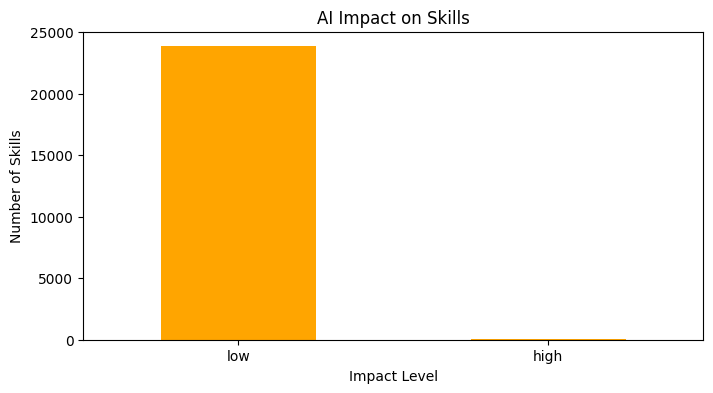

In [133]:
# Analyzing text descriptions to infer AI impact, assuming descriptions mention automation or AI
df['AI_Impact'] = df['Skills Statement'].apply(lambda x: 'high' if 'AI' in x.lower() or 'automation' in x.lower() else 'low')

# Visualize the distribution of AI impact on skills
ai_impact_counts = df['AI_Impact'].value_counts()
plt.figure(figsize=(8, 4))
ai_impact_counts.plot(kind='bar', color='orange')
plt.title('AI Impact on Skills')
plt.xlabel('Impact Level')
plt.ylabel('Number of Skills')
plt.xticks(rotation=0)
plt.show()

In [134]:
import spacy
nlp = spacy.load("en_core_web_sm")

def process_text(text):
    doc = nlp(text)
    lemmatized = " ".join([token.lemma_ for token in doc if not token.is_stop])
    pos_tags = " ".join([token.pos_ for token in doc])
    return lemmatized, pos_tags

# Apply text processing to extract lemmatized text and POS tags
df['lemmatized'], df['pos_tags'] = zip(*df['Skills Statement'].apply(process_text))


In [126]:
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd

def create_cooccurrence_matrix(text, vocab=None):
    count_model = CountVectorizer(ngram_range=(1,1), vocabulary=vocab)  # Default unigram model
    X = count_model.fit_transform(text)
    Xc = (X.T * X)  # This is the co-occurrence matrix in sparse csr format
    Xc.setdiag(0)  # Set the diagonals to be zeroes as we don't want to count self co-occurrences
    coocc_arr = Xc.toarray()
    vocab = count_model.get_feature_names_out()
    return pd.DataFrame(coocc_arr, index=vocab, columns=vocab)

# Create a co-occurrence matrix for the lemmatized text
coocc_matrix = create_cooccurrence_matrix(df['lemmatized'])


In [127]:
!pip install textblob

In [136]:
print(df[['ANZSCO Description', 'sentiment_polarity']])

KeyError: "['sentiment_polarity'] not in index"

In [138]:
from textblob import TextBlob

# Function to calculate sentiment polarity
def sentiment_analysis(text):
    return TextBlob(text).sentiment.polarity

df['sentiment'] = df['lemmatized'].apply(sentiment_analysis)


In [139]:
import pandas as pd
from textblob import TextBlob

# # Function to calculate sentiment polarity
# def calculate_sentiment(text):
#     return TextBlob(text).sentiment.polarity

# Apply sentiment analysis on the 'ANZSCO Description' column
df['sentiment_polarity'] = df['ANZSCO Description'].apply(calculate_sentiment)


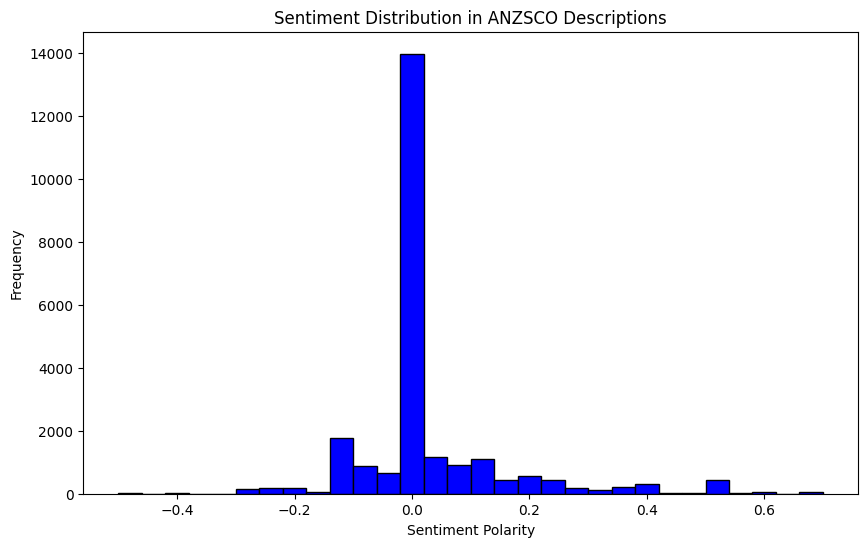

In [140]:
import matplotlib.pyplot as plt

# Plotting the sentiment distribution
plt.figure(figsize=(10, 6))
plt.hist(df['sentiment_polarity'], bins=30, color='blue', edgecolor='black')
plt.title('Sentiment Distribution in ANZSCO Descriptions')
plt.xlabel('Sentiment Polarity')
plt.ylabel('Frequency')
plt.show()

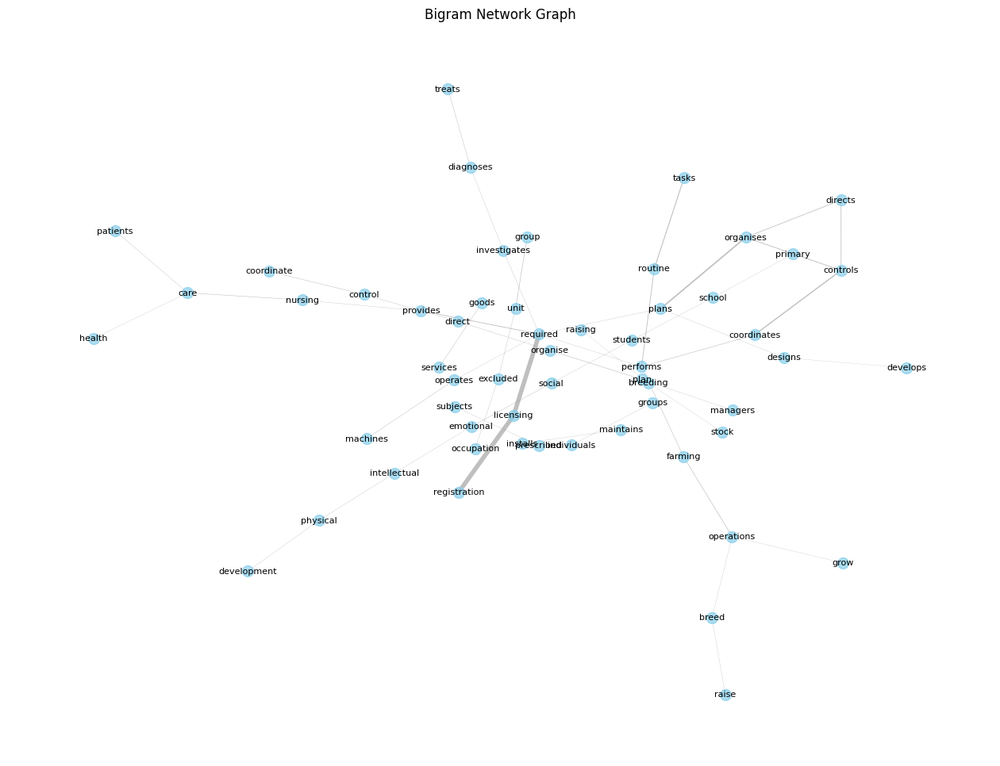

In [141]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from nltk import bigrams
from collections import Counter
import spacy

# Load and prepare your data
nlp = spacy.load('en_core_web_sm')
df['tokenized'] = df['ANZSCO Description'].apply(lambda x: [token.text.lower() for token in nlp(x) if not token.is_stop and not token.is_punct])

def plot_bigram_network(tokens, n=50):
    # Create bigrams and count their frequencies
    bi_grams = list(bigrams(tokens))
    bigram_freq = Counter(bi_grams)

    # Create a graph
    G = nx.Graph()
    for bigram, count in bigram_freq.most_common(n):
        G.add_edge(bigram[0], bigram[1], weight=count)

    # Define node positions using the Kamada-Kawai layout algorithm for better visualization
    pos = nx.kamada_kawai_layout(G, weight=None)  # `weight=None` ignores the weights for layout calculation

    # Draw the graph
    plt.figure(figsize=(16, 12))
    nx.draw_networkx_nodes(G, pos, node_size=100, node_color='skyblue', alpha=0.7)
    edge_widths = [d['weight'] for (u, v, d) in G.edges(data=True)]
    nx.draw_networkx_edges(G, pos, width=4*np.array(edge_widths)/max(edge_widths), alpha=0.5, edge_color='gray')
    nx.draw_networkx_labels(G, pos, font_size=8, font_family='sans-serif')
    plt.title('Bigram Network Graph')
    plt.axis('off')
    plt.show()

# Concatenate tokens from all descriptions into a single list
all_tokens = [token for sublist in df['tokenized'] for token in sublist]
plot_bigram_network(all_tokens)


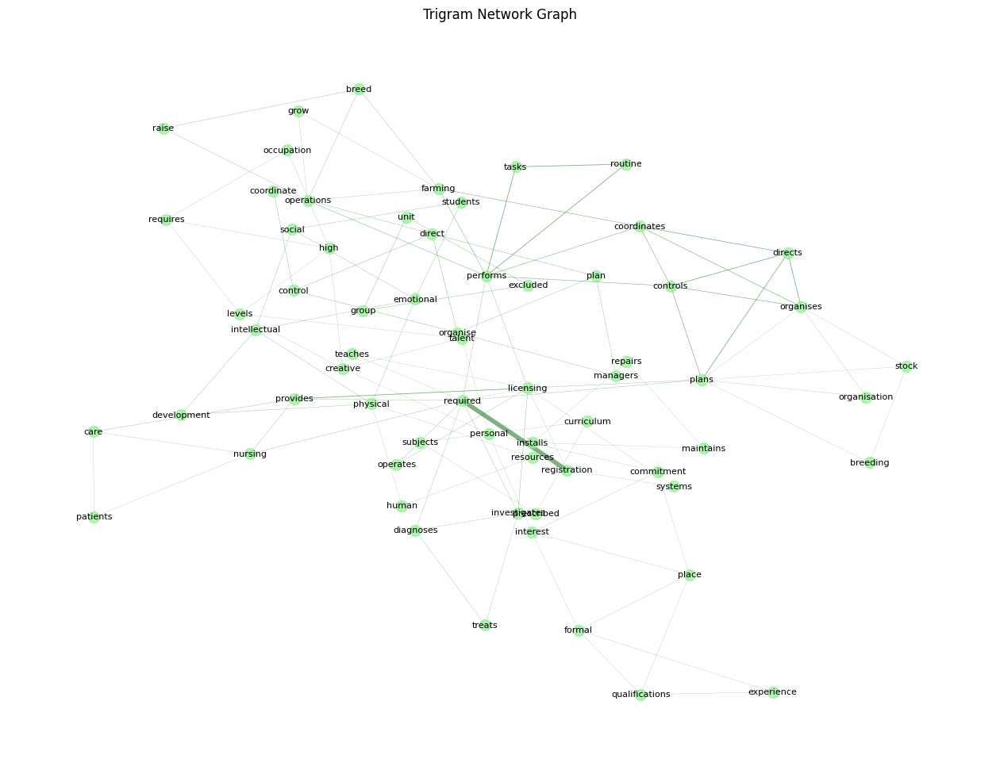

In [142]:
from nltk import trigrams

def plot_trigram_network(tokens, n=50):
    # Create trigrams and count their frequencies
    tri_grams = list(trigrams(tokens))
    trigram_freq = Counter(tri_grams)

    # Create a graph
    G = nx.Graph()
    for trigram, count in trigram_freq.most_common(n):
        # Add edges between each pair of words in the trigram
        G.add_edge(trigram[0], trigram[1], weight=count)
        G.add_edge(trigram[1], trigram[2], weight=count)
        # Optionally add a hyperedge-like component if you want to visualize all three connections together
        G.add_edge(trigram[0], trigram[2], weight=count)

    # Define node positions using the Kamada-Kawai layout algorithm for better visualization
    pos = nx.kamada_kawai_layout(G, weight=None)  # `weight=None` ignores the weights for layout calculation

    # Draw the graph
    plt.figure(figsize=(16, 12))
    nx.draw_networkx_nodes(G, pos, node_size=100, node_color='lightgreen', alpha=0.7)
    edge_widths = [d['weight'] for (u, v, d) in G.edges(data=True)]
    nx.draw_networkx_edges(G, pos, width=4*np.array(edge_widths)/max(edge_widths), alpha=0.5, edge_color='darkgreen')
    nx.draw_networkx_labels(G, pos, font_size=8, font_family='sans-serif')
    plt.title('Trigram Network Graph')
    plt.axis('off')
    plt.show()

# Concatenate tokens from all descriptions into a single list
plot_trigram_network(all_tokens)


In [143]:
import pandas as pd
import spacy
from spacy import displacy # Corrected import to 'displacy'
# Select the first 1000 rows
df_subset = df.iloc[:1000]
nlp = spacy.load('en_core_web_sm')
# Processing the first description for dependency parsing
doc = nlp(df_subset['ANZSCO Description'].iloc[0])

# Visualize the dependency tree
displacy.render(doc, style='dep', jupyter=True, options={'distance': 100}) # Using 'displacy' with lowercase 'c'

# Define a function to visualize dependency trees for multiple descriptions
def visualize_dependency_trees(df, column_name, num_trees=5):
    for text in df[column_name].head(num_trees):
        doc = nlp(text)
        displacy.render(doc, style='dep', options={'distance': 100}, jupyter=True) # Using 'displacy' with lowercase 'c'

# Apply the function to visualize the first 5 descriptions' dependency trees
visualize_dependency_trees(df_subset, 'ANZSCO Description')

In [144]:
import pandas as pd
import spacy

# Load spaCy model
nlp = spacy.load('en_core_web_sm')

# Define a function to process a chunk
def process_chunk(chunk):
    # Apply the NLP pipeline to each text entry
    chunk['processed'] = chunk['ANZSCO Description'].apply(lambda x: [(ent.text, ent.label_) for ent in nlp(x).ents])
    return chunk

# Initialize an empty DataFrame to store results
processed_data = pd.DataFrame()

# Read the dataset in chunks
chunk_size = 1000  # Define your chunk size based on your memory capacity
for chunk in pd.read_csv(url, chunksize=chunk_size):
    processed_chunk = process_chunk(chunk)
    processed_data = pd.concat([processed_data, processed_chunk])




In [145]:
import plotly.graph_objects as go
import networkx as nx
from nltk import bigrams
from collections import Counter
import spacy
import pandas as pd

# Load your data and process it
nlp = spacy.load('en_core_web_sm')
df['tokenized'] = df['ANZSCO Description'].apply(lambda x: [token.text.lower() for token in nlp(x) if not token.is_stop and not token.is_punct])

def plotly_interactive_bigram_network(tokens, n=50):
    bi_grams = list(bigrams(tokens))
    bigram_freq = Counter(bi_grams)

    # Create network graph
    G = nx.Graph()
    for bigram, count in bigram_freq.most_common(n):
        G.add_edge(bigram[0], bigram[1], weight=count)

    # Position nodes using the Fruchterman-Reingold force-directed algorithm
    pos = nx.spring_layout(G, k=0.5, iterations=100)  # You can adjust k for more space

    edge_x = []
    edge_y = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])

    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='blue'),
        hoverinfo='none',
        mode='lines')

    node_x = [pos[node][0] for node in G.nodes()]
    node_y = [pos[node][1] for node in G.nodes()]

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers+text',
        hoverinfo='text',
        marker=dict(showscale=True,
                    colorscale='Viridis',
                    size=10,
                    color=list(dict(G.degree()).values()),
                    colorbar=dict(thickness=15, title='Node Connections', xanchor='left', titleside='right'),
                    line_width=2))

    node_text = [f'{node} ({G.degree(node)})' for node in G.nodes()]
    node_trace.text = node_text
    node_trace.marker.color = [len(G.edges(node)) for node in G.nodes()]

    fig = go.Figure(data=[edge_trace, node_trace],
                    layout=go.Layout(
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=0,l=0,r=0,t=0),
                        xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                        yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                        title_text="Interactive Bigram Network Graph",
                        title_font_size=16))

    fig.update_layout(template="plotly_dark")
    fig.show()

# Concatenate tokens from all descriptions into a single list
all_tokens = [token for sublist in df['tokenized'] for token in sublist]
plotly_interactive_bigram_network(all_tokens)


For n_clusters = 2, the average silhouette_score is : 0.016907956451177597
For n_clusters = 3, the average silhouette_score is : 0.01951168105006218
For n_clusters = 4, the average silhouette_score is : 0.02120300754904747
For n_clusters = 5, the average silhouette_score is : 0.021110709756612778


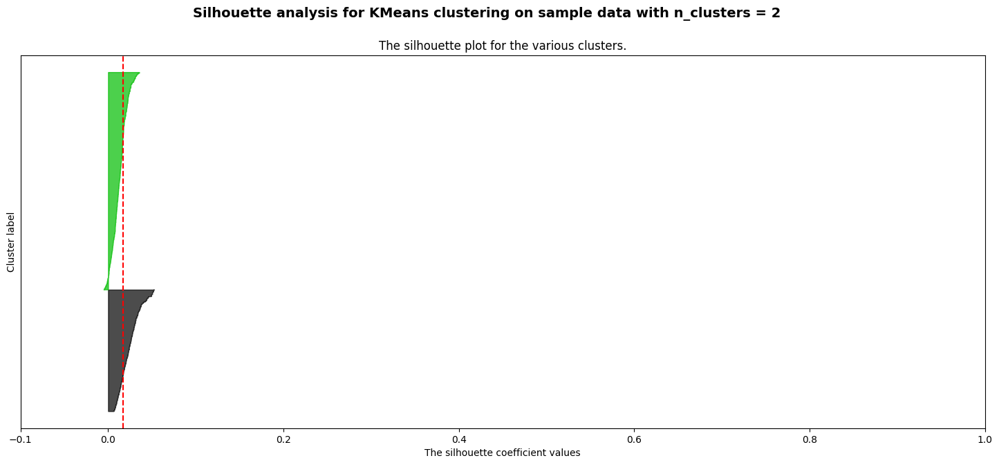

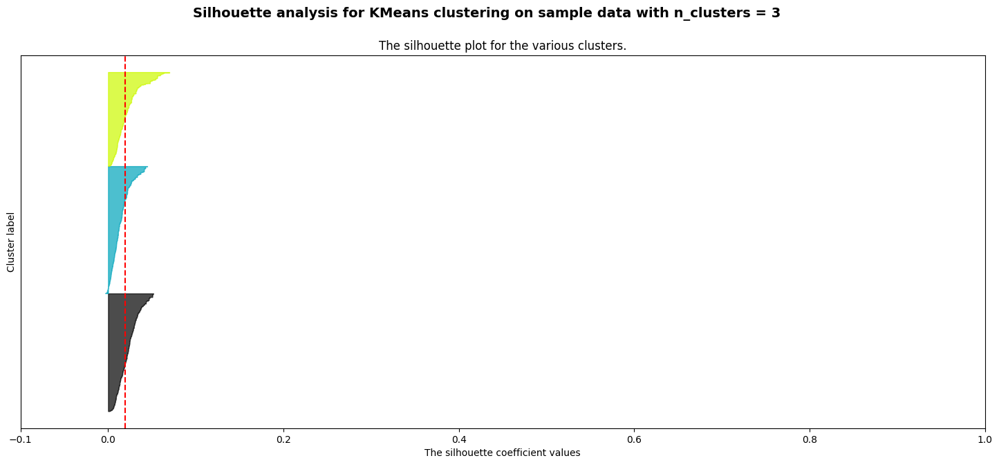

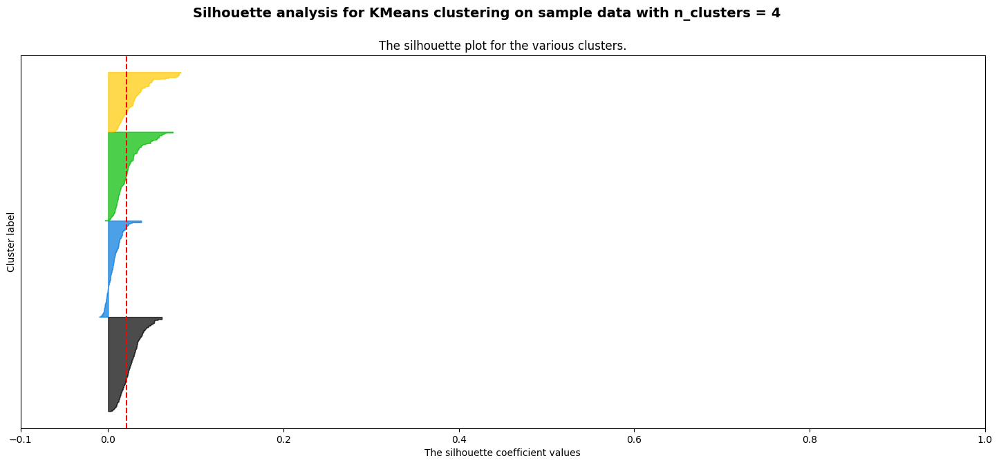

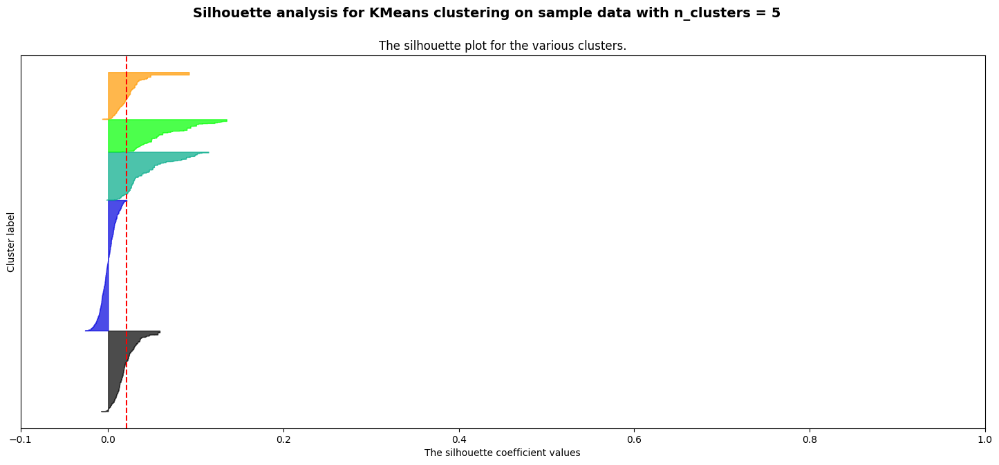

In [146]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
from sklearn.cluster import KMeans

def silhouette_plot(X, range_n_clusters=[2, 3, 4, 5]):
    for n_clusters in range_n_clusters:
        fig, ax1 = plt.subplots(1, 1)
        fig.set_size_inches(18, 7)

        kmeans = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = kmeans.fit_predict(X)

        silhouette_avg = silhouette_score(X, cluster_labels)
        print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg}")

        sample_silhouette_values = silhouette_samples(X, cluster_labels)
        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
            ith_cluster_silhouette_values.sort()
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i
            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor=color, edgecolor=color, alpha=0.7)
            y_lower = y_upper + 10

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
        ax1.set_yticks([])
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        plt.suptitle(f"Silhouette analysis for KMeans clustering on sample data with n_clusters = {n_clusters}", fontsize=14, fontweight='bold')

silhouette_plot(tfidf_matrix.toarray())


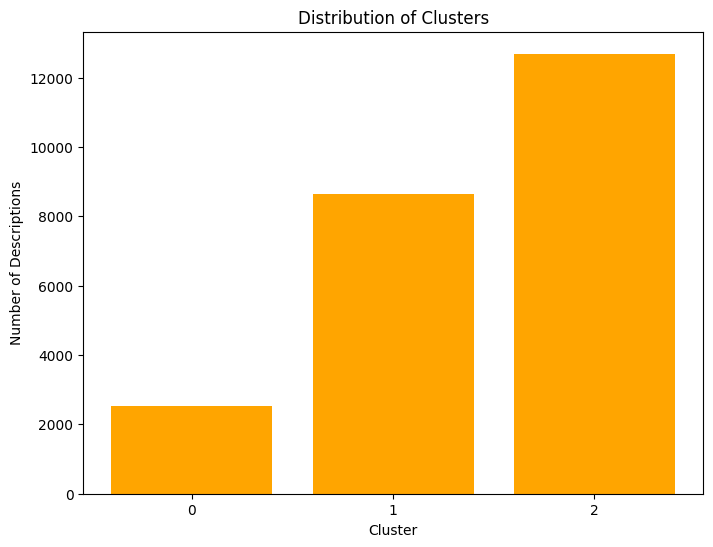

In [147]:
# Perform K-means clustering on the TF-IDF matrix
def perform_kmeans(X, n_clusters=3):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(X)
    labels = kmeans.labels_

    # Plotting the results
    plt.figure(figsize=(8, 6))
    plt.hist(labels, bins=range(n_clusters + 1), align='left', color='orange', rwidth=0.8)
    plt.title('Distribution of Clusters')
    plt.xlabel('Cluster')
    plt.ylabel('Number of Descriptions')
    plt.xticks(range(n_clusters))
    plt.show()

    return labels

kmeans_labels = perform_kmeans(tfidf_matrix.toarray(), n_clusters=3)


In [148]:
# Assuming clustering labels are from a previous model run (e.g., K-means)
from sklearn.metrics import silhouette_score

def evaluate_clustering(X, labels):
    silhouette_avg = silhouette_score(X, labels)
    print("Silhouette Score: {:.2f}".format(silhouette_avg))

evaluate_clustering(tfidf_matrix.toarray(), kmeans_labels)


Silhouette Score: 0.02


<ipython-input-149-fbf8cdc05173>:11: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




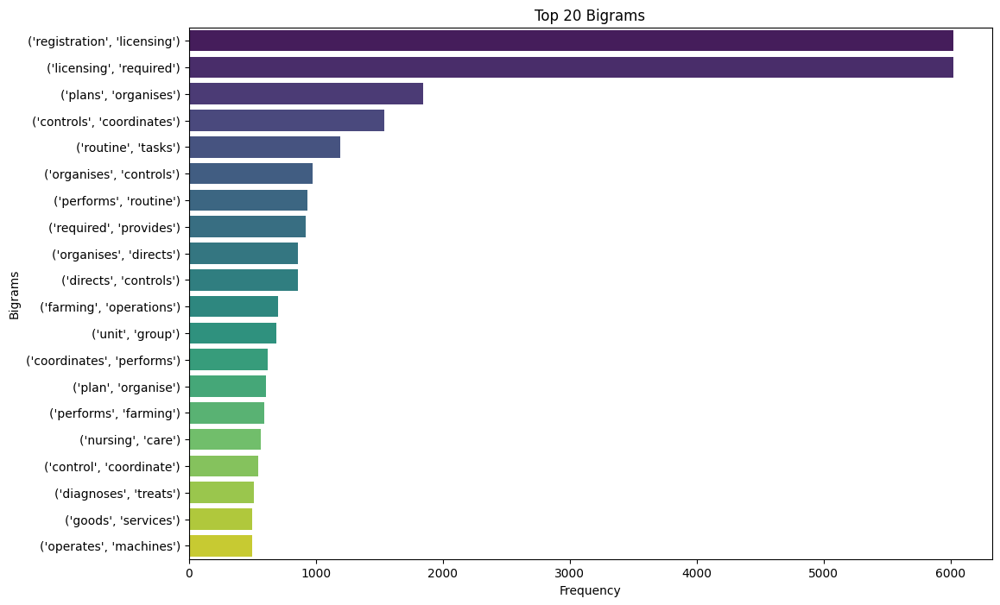

In [149]:
# Enhanced Visualization of N-grams and Clustering Results
import seaborn as sns
from nltk import bigrams # Import bigrams
from collections import Counter # Import Counter

def visualize_ngrams(ngrams):
    ngram_df = pd.DataFrame(ngrams.most_common(20), columns=['bigram', 'count'])
    # Convert the 'bigram' column to strings for plotting
    ngram_df['bigram'] = ngram_df['bigram'].astype(str) # This line fixes the error
    plt.figure(figsize=(12, 8))
    sns.barplot(x='count', y='bigram', data=ngram_df, palette='viridis')
    plt.title('Top 20 Bigrams')
    plt.xlabel('Frequency')
    plt.ylabel('Bigrams')
    plt.show()

# Assuming 'df' is your DataFrame and 'ANZSCO Description' is the column with text
df['tokenized'] = df['ANZSCO Description'].apply(lambda x: [token.text.lower() for token in nlp(x) if not token.is_stop and not token.is_punct])
all_tokens = [token for sublist in df['tokenized'] for token in sublist] # Re-create all_tokens here
bi_grams = list(bigrams(all_tokens)) # Re-create bi_grams here using all_tokens
bigram_freq = Counter(bi_grams)  # Now bi_grams is defined and can be used
visualize_ngrams(bigram_freq)

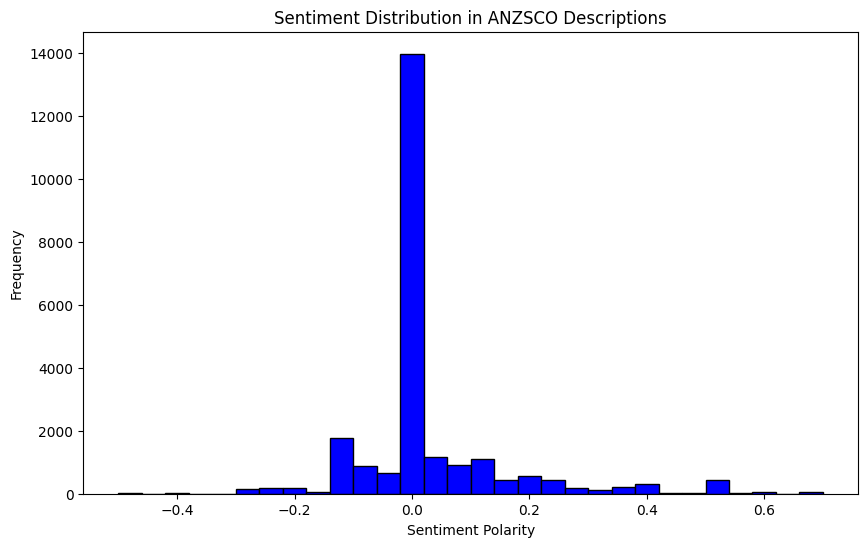

,Sentiment Polarity Range,Frequency
0,-0.50 to -0.46,14
1,-0.46 to -0.42,0
2,-0.42 to -0.38,23
3,-0.38 to -0.34,0
4,-0.34 to -0.30,0
5,-0.30 to -0.26,141
6,-0.26 to -0.22,173
7,-0.22 to -0.18,169
8,-0.18 to -0.14,60
9,-0.14 to -0.10,1761


In [150]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from textblob import TextBlob

# Function to calculate sentiment polarity (if not already defined)
def calculate_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Apply sentiment analysis if 'sentiment_polarity' column doesn't exist
if 'sentiment_polarity' not in df.columns:
    df['sentiment_polarity'] = df['ANZSCO Description'].apply(calculate_sentiment)

# Plotting the sentiment distribution and getting histogram data
counts, bin_edges = np.histogram(df['sentiment_polarity'], bins=30)  # Get histogram data

plt.figure(figsize=(10, 6))
plt.hist(df['sentiment_polarity'], bins=30, color='blue', edgecolor='black')
plt.title('Sentiment Distribution in ANZSCO Descriptions')
plt.xlabel('Sentiment Polarity')
plt.ylabel('Frequency')
plt.show()

# Create a DataFrame for the histogram data
hist_data = pd.DataFrame({
    'Sentiment Polarity Range': pd.Series(bin_edges[:-1]).apply(lambda x: f"{x:.2f}") + " to " + pd.Series(bin_edges[1:]).apply(lambda x: f"{x:.2f}"),
    'Frequency': counts
})

# Display the table
display(hist_data)

spaCy medium model not found. Installing now...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.8/42.8 MB 30.4 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_md')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


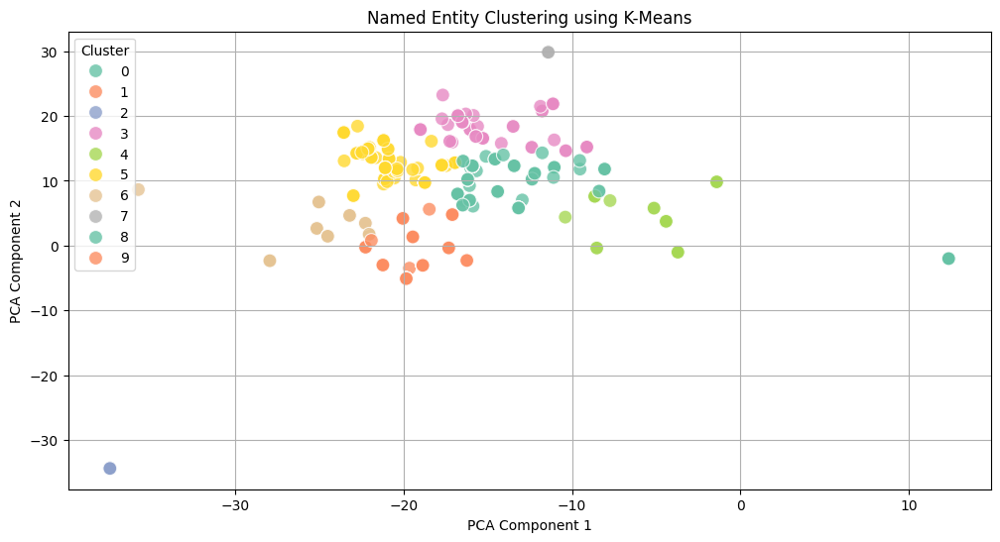


Cluster 0:
Digital

Cluster 1:
Quality, Recruit, Communication, Communicate, Advise, Program, Control

Cluster 2:
Health

Cluster 3:
Calculate, Record, Signal, Harvest, Drive, File, Fabricate, Follow, Track, Configure

Cluster 4:
Data, Science and Mathematics Digital, Direct, Art, Document ICT, Construction Digital, Develop ICT, Design

Cluster 5:
Administer non-intravenous, Administer, Evaluate, Detain, Construct, Coordinate, Operate, Vehicle, Weigh, Calibrate

Cluster 6:
Safety, Assess, Act, Recreation, Agriculture, Enforce, Plan, Care for animals Agriculture

Cluster 7:
Records

Cluster 8:
Review, Mark, Analyse, Customer, Distribute, Fashion, Material, Package, Connect, Collect

Cluster 9:
Science, Research, Develop, Security, Food, Environmental


In [151]:
# Load the spaCy medium-sized model for better word embeddings
import spacy
import numpy as np  # Import spaCy

from sklearn.decomposition import PCA # Import PCA
from sklearn.cluster import KMeans # Import KMeans
import matplotlib.pyplot as plt # Import matplotlib.pyplot
import seaborn as sns # Import seaborn and alias it as sns

try:
    nlp = spacy.load("en_core_web_md")
except OSError:
    print("spaCy medium model not found. Installing now...")
    !python -m spacy download en_core_web_md
    nlp = spacy.load("en_core_web_md")


# Selecting the relevant columns
new_df = df[['ANZSCO Title', 'Specialist Task', 'Cluster Family', 'Core Competency']].dropna()

# Sample a subset of data for performance optimization
new_df_sample = new_df.sample(frac=0.05, random_state=42)

# Combine all text from the selected columns into a single string
text_data = " ".join(new_df_sample.astype(str).apply(lambda x: ' '.join(x), axis=1))

# Process text with spaCy NLP pipeline
nlp = spacy.load("en_core_web_md")  # Load model
doc = nlp(text_data)

# Extract named entities ensuring they have vector representations
entities = [(ent.text, ent.label_) for ent in doc.ents if ent.has_vector]

# Convert entity text into vectors using spaCy's word embeddings
entity_texts = [ent[0] for ent in entities]
entity_vectors = np.array([nlp(ent[0]).vector for ent in entities if nlp(ent[0]).has_vector])

# Reduce dimensions using PCA for better visualization
pca = PCA(n_components=2)
entity_vectors_pca = pca.fit_transform(entity_vectors)

# Apply K-Means clustering
num_clusters = 10  # Set number of clusters
kmeans = KMeans(n_clusters=num_clusters, random_state=42, n_init=10) # KMeans is now imported
clusters = kmeans.fit_predict(entity_vectors_pca)

# Create DataFrame for visualization
cluster_df = pd.DataFrame({
    "Entity": entity_texts[:len(entity_vectors_pca)],
    "X": entity_vectors_pca[:, 0],
    "Y": entity_vectors_pca[:, 1],
    "Cluster": clusters
})

# Plot Clustering Results
plt.figure(figsize=(12, 6))
sns.scatterplot(data=cluster_df, x="X", y="Y", hue="Cluster", palette="Set2", s=100, alpha=0.8)
plt.xlabel("PCA Component 1")
plt.ylabel("PCA Component 2")
plt.title("Named Entity Clustering using K-Means")
plt.legend(title="Cluster")
plt.grid(True)
plt.show()

# Display top entities in each cluster
for cluster in range(num_clusters):
    cluster_entities = cluster_df[cluster_df["Cluster"] == cluster]["Entity"].unique()[:10]  # Show top 10 per cluster
    print(f"\nCluster {cluster}:")
    print(", ".join(cluster_entities))

In [152]:
!pip install gensim

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 36.3 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.14.1
    Uninstalling scipy-1.14.1:
      Successfully uninstalled scipy-1.14.1


In [153]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer
from gensim.corpora import Dictionary
from gensim.models.ldamodel import LdaModel
from gensim.models.coherencemodel import CoherenceModel

# Load data
# Assuming the data is in a CSV file and loaded into DataFrame `df`
# df = pd.read_csv('your_data.csv')

# Download NLTK resources
nltk.download('stopwords')

# Tokenization and removing punctuation
tokenizer = RegexpTokenizer(r'\w+')

# Stop words
stop_words = set(stopwords.words('english'))

# Function to preprocess text
def preprocess(text):
    tokens = tokenizer.tokenize(text.lower())
    filtered_tokens = [w for w in tokens if not w in stop_words]
    return filtered_tokens

# Apply preprocessing to the 'Skills Statement' column
df['processed'] = df['Skills Statement'].map(preprocess)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [154]:
# Create a dictionary representation of the documents
dictionary = Dictionary(df['processed'])

# Filter out extremes to remove noise and words that are too frequent
dictionary.filter_extremes(no_below=20, no_above=0.5)

# Create a corpus
corpus = [dictionary.doc2bow(text) for text in df['processed']]

In [155]:
# Train LDA model
lda_model = LdaModel(corpus=corpus,
                     id2word=dictionary,
                     num_topics=10,
                     random_state=100,
                     update_every=1,
                     chunksize=100,
                     passes=10,
                     alpha='auto',
                     per_word_topics=True)

In [156]:
top_words_per_topic = []
for topic_idx, topic in enumerate(lda_model.get_topics()):
    top_features_ind = topic.argsort()[-10:][::-1]  # Change 10 to however many words you want
    top_features = [dictionary[id] for id in top_features_ind]
    weights = topic[top_features_ind]
    top_words_per_topic.append((topic_idx, list(zip(top_features, weights))))

# Print the top words along with their weights for each topic
for topic, words in top_words_per_topic:
    print(f"Topic {topic + 1}:")
    for word, weight in words:
        print(f"  {word} {weight:.4f}")
    print("\n")


Topic 1:
  information 0.0763
  relevant 0.0404
  records 0.0391
  according 0.0367
  ensuring 0.0270
  requirements 0.0229
  ensure 0.0218
  details 0.0206
  accurate 0.0204
  policies 0.0173


Topic 2:
  patient 0.0401
  relevant 0.0373
  issues 0.0305
  data 0.0284
  information 0.0254
  service 0.0173
  identify 0.0172
  order 0.0147
  involve 0.0139
  analysis 0.0136


Topic 3:
  example 0.0491
  environments 0.0363
  social 0.0301
  practices 0.0255
  action 0.0169
  wellbeing 0.0160
  principles 0.0141
  people 0.0137
  information 0.0129
  apply 0.0123


Topic 4:
  record 0.0468
  include 0.0363
  levels 0.0319
  stock 0.0233
  keeping 0.0228
  including 0.0205
  conducting 0.0199
  maintain 0.0184
  accordance 0.0182
  monitoring 0.0166


Topic 5:
  include 0.0358
  providing 0.0346
  technical 0.0328
  activities 0.0261
  required 0.0225
  information 0.0198
  project 0.0193
  processes 0.0188
  operational 0.0183
  specialist 0.0181


Topic 6:
  needs 0.0297
  learning 0.028

In [157]:
# Assuming lda_model, corpus, dictionary, and processed text are already defined

# Compute Coherence Score using c_v method
coherence_model_lda = CoherenceModel(model=lda_model, texts=df['processed'], dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Coherence Score:  0.43381428611824047
